<a href="https://colab.research.google.com/github/7angel4/weighted-jk/blob/main/JKGCN_experiments.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Set up dependencies
Run the following blocks of code to install the required packages.

In [1]:
!python -c "import torch; print(torch.__version__)"

2.6.0.dev20241112


In [2]:
%%capture
!pip uninstall torch-scatter torch-sparse torch-geometric torch-cluster  --y
!pip install torch-scatter -f https://data.pyg.org/whl/torch-2.0.1+cu118.html
!pip install torch-sparse -f https://data.pyg.org/whl/torch-2.0.1+cu118.html
!pip install torch-cluster -f https://data.pyg.org/whl/torch-2.0.1+cu118.html
!pip install git+https://github.com/pyg-team/pytorch_geometric.git

#### Import required packages

Please run the below code block to import the required python packages.

In [3]:
import torch
import os
import typing
import torch_geometric

import torch.nn as nn
import torch.nn.functional as F
import torch_geometric.datasets as datasets
import numpy as np

from torch_geometric.nn import GCNConv
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

In [9]:
torch.manual_seed(87878) # set seed

In [4]:
# same as imports
%run datasets.ipynb
%run models.ipynb
%run train_eval.ipynb
%run visualisation.ipynb

Processing...
Done!
Processing...
Done!
Processing...
Done!


In [7]:
NUM_RUNS = 5

def repeat_experiment(params, num_runs=5):
    all_runs = [ train_and_test(params, layers=TRAIN_LAYERS, 
                                report_per_period=params['epochs']+1,
                                print_results=False, export_results=False)
                     for _ in range(num_runs) ]
    all_run_results = {}  # num layers : list of results across all runs
    all_run_hyperparams = {}
    all_run_models = {}
    for n in TRAIN_LAYERS:
        all_run_models[n] = [run[0][n] for run in all_runs]
        all_run_results[n] = [run[1][n] for run in all_runs]
        all_run_hyperparams[n] = [run[2][n] for run in all_runs]
        
    avg_results = {n : EvalResults.average(results, std=True)
                   for (n, results) in all_run_results.items()}
    return all_run_models, avg_results, all_run_hyperparams

In [ ]:
# This will take a while
cora_results = { model: repeat_experiment(training_params(model, 'Cora'), num_runs=5)
                 for model in MODELS }
pubmed_results = { model: repeat_experiment(training_params(model, 'PubMed'), num_runs=5)
                   for model in MODELS }
citeseer_results = { model: repeat_experiment(training_params(model, 'CiteSeer'), num_runs=5)
                     for model in MODELS }
dataset_to_results = {'Cora': cora_results, 'CiteSeer': citeseer_results, 'PubMed': pubmed_results}

In [8]:
def extract_models(experiment_results, layers=range(2,21,6)):
    # {model : {num layers : 2 } }
    all_res = { model: res[0] for (model, res) in experiment_results.items() }
    return {model: {n: res[n] for n in layers} for model, res in all_res.items()}

def extract_all_init_res_weights(experiment_results, layers=TRAIN_LAYERS):
    layers_to_hyperparams = experiment_results['WSkipGNN'][2]
    return {n: [ hp['init_res_weight'] for hp in hps ] 
            for n,hps in layers_to_hyperparams.items() if n in layers}

def extract_all_final_res_weights(experiment_results, layers=TRAIN_LAYERS):
    layers_to_models = extract_models(experiment_results, layers=layers)['WSkipGNN']
    return { n: [float(m.res_weight) for m in models] 
            for n, models in layers_to_models.items() }

def extract_results(experiment_results, layers=range(2,21,6)):
    """
    Returns the results (mean eval. metrics, stderr) for selected layers
    """
    # {model : {num layers : (mean metrics, stderr metrics) } }
    all_res = { model: res[1] for (model, res) in experiment_results.items() }
    return {model: {n: res[n] for n in layers} for model, res in all_res.items()}

In [132]:
extract_all_init_res_weights(cora_results)

{2: [-0.20000000000000018,
  -0.20000000000000018,
  0.3999999999999997,
  -1.0,
  -0.20000000000000018],
 4: [-2.220446049250313e-16,
  -0.8,
  -1.0,
  -0.6000000000000001,
  0.19999999999999973],
 6: [-0.6000000000000001,
  0.9999999999999996,
  -0.20000000000000018,
  -0.8,
  0.9999999999999996],
 8: [-1.0, -0.20000000000000018, -1.0, -0.6000000000000001, -0.8],
 10: [-0.6000000000000001, -1.0, -0.8, -0.8, -0.8],
 12: [-1.0, -0.8, -1.0, -1.0, -0.8],
 14: [-0.6000000000000001, -1.0, -1.0, -0.8, -1.0],
 16: [-0.8, -1.0, -1.0, -0.8, -1.0],
 18: [-0.8, -0.8, -0.8, 0.7999999999999996, -0.8],
 20: [-0.8, -1.0, -1.0, -1.0, -0.8]}

In [118]:
cora_results['WSkipGNN']

({2: [WSkipGNN(
     (layers): ModuleList(
       (0): GCNConv(1433, 64)
       (1): GCNConv(64, 64)
     )
     (mlp): Linear(in_features=64, out_features=7, bias=True)
   ),
   WSkipGNN(
     (layers): ModuleList(
       (0): GCNConv(1433, 64)
       (1): GCNConv(64, 64)
     )
     (mlp): Linear(in_features=64, out_features=7, bias=True)
   ),
   WSkipGNN(
     (layers): ModuleList(
       (0): GCNConv(1433, 64)
       (1): GCNConv(64, 64)
     )
     (mlp): Linear(in_features=64, out_features=7, bias=True)
   ),
   WSkipGNN(
     (layers): ModuleList(
       (0): GCNConv(1433, 64)
       (1): GCNConv(64, 64)
     )
     (mlp): Linear(in_features=64, out_features=7, bias=True)
   ),
   WSkipGNN(
     (layers): ModuleList(
       (0): GCNConv(1433, 64)
       (1): GCNConv(64, 64)
     )
     (mlp): Linear(in_features=64, out_features=7, bias=True)
   )],
  4: [WSkipGNN(
     (layers): ModuleList(
       (0): GCNConv(1433, 64)
       (1-3): 3 x GCNConv(64, 64)
     )
     (mlp): Linea

In [211]:
for dataset, results in dataset_to_results.items():
    print(f'{dataset} results:')
    print(extract_results(citeseer_results, layers=[2,10,20]))
    print()

Cora results:
{'PlainGNN': {2: (mic_f1: 0.6438, mac_f1: 0.6217, mic_f1: 0.0058, mac_f1: 0.0066), 10: (mic_f1: 0.3282, mac_f1: 0.2625, mic_f1: 0.0443, mac_f1: 0.0447), 20: (mic_f1: 0.1468, mac_f1: 0.0856, mic_f1: 0.0168, mac_f1: 0.0102)}, 'SkipGNN': {2: (mic_f1: 0.6246, mac_f1: 0.6049, mic_f1: 0.0061, mac_f1: 0.0057), 10: (mic_f1: 0.4316, mac_f1: 0.3745, mic_f1: 0.0507, mac_f1: 0.0595), 20: (mic_f1: 0.1630, mac_f1: 0.0538, mic_f1: 0.0193, mac_f1: 0.0091)}, 'JumpKGNN': {2: (mic_f1: 0.6104, mac_f1: 0.5933, mic_f1: 0.0195, mac_f1: 0.0159), 10: (mic_f1: 0.1168, mac_f1: 0.0368, mic_f1: 0.0201, mac_f1: 0.0050), 20: (mic_f1: 0.1348, mac_f1: 0.0391, mic_f1: 0.0212, mac_f1: 0.0056)}, 'WSkipGNN': {2: (mic_f1: 0.6350, mac_f1: 0.6144, mic_f1: 0.0030, mac_f1: 0.0038), 10: (mic_f1: 0.5910, mac_f1: 0.5681, mic_f1: 0.0112, mac_f1: 0.0112), 20: (mic_f1: 0.4724, mac_f1: 0.4458, mic_f1: 0.0562, mac_f1: 0.0547)}}

CiteSeer results:
{'PlainGNN': {2: (mic_f1: 0.6438, mac_f1: 0.6217, mic_f1: 0.0058, mac_f1: 0

In [9]:
def aggr_init_res_weights(experimental_results, layers=TRAIN_LAYERS):
    """
    Returns mean and stderr of initial residual weights used in training.
    """
    layers_to_init_ws = extract_all_init_res_weights(experimental_results, layers=layers)
    layers_to_mean_init = { n: np.mean(ws) for n,ws in layers_to_init_ws.items() }
    layers_to_stderr_init = { n: stderr(ws) for n,ws in layers_to_init_ws.items() }
    return layers_to_mean_init, layers_to_stderr_init

In [189]:
aggr_init_res_weights(citeseer_results, layers=TRAIN_LAYERS)

({2: -2.220446049250313e-16,
  4: 0.3999999999999997,
  6: 0.11999999999999975,
  8: -0.68,
  10: -0.7600000000000001,
  12: -0.8,
  14: -0.8400000000000001,
  16: -0.9199999999999999,
  18: -0.9199999999999999,
  20: -0.8799999999999999},
 {2: 0.3346640106136301,
  4: 0.26076809620810587,
  6: 0.3878143885933062,
  8: 0.1496662954709576,
  10: 0.0979795897113271,
  12: 0.06324555320336757,
  14: 0.0748331477354788,
  16: 0.04898979485566355,
  18: 0.04898979485566355,
  20: 0.04898979485566355})

## Visualisation

In [190]:
def plot_res_weights(dataset_to_results, layers=range(2,21,6), label_vals=False):
    """
    Plot initial vs. final residual weights for all datasets.
    """
    colors = {'Cora': 'blue', 'PubMed': 'green', 'CiteSeer': 'red'}
    dataset_to_mean_ws, dataset_to_stderr_ws = {}, {}
                   
    for dataset_name in DATASETS:
        experiment_results = dataset_to_results[dataset_name]
        layers_to_init_ws = extract_all_init_res_weights(experiment_results, layers=layers)
        # map weights across all runs to mean, stderr
        layers_to_mean_init = { n: np.mean(ws) for n,ws in layers_to_init_ws.items() }
        layers_to_stderr_init = { n: stderr(ws) for n,ws in layers_to_init_ws.items() }
        # plot with error bars for initial weights
        init_line = plt.errorbar(layers, layers_to_mean_init.values(), yerr=layers_to_stderr_init.values(),
                                 label=f'{dataset_name} - Initial', color=colors[dataset_name], markersize=3,
                                 fmt='o', capsize=3, linestyle=':')
    
        layers_to_ws = extract_all_final_res_weights(experiment_results, layers=layers)
        layers_to_mean_final = { n: np.mean(ws) for n,ws in layers_to_ws.items() }
        layers_to_stderr_final = { n: stderr(ws) for n,ws in layers_to_ws.items() }
        # plot with error bars for final weights
        final_line = plt.errorbar(layers, layers_to_mean_final.values(), yerr=layers_to_stderr_final.values(),
                                  label=f'{dataset_name} - Final', color=colors[dataset_name], markersize=3,
                                  fmt='o', capsize=3, linestyle='-')
        
        dataset_to_mean_ws[dataset_name] = layers_to_mean_final
        dataset_to_stderr_ws[dataset_name] = layers_to_std_final

        # Add labels
        if label_vals:
            for i, layer in enumerate(layers):
                # for initial weights (above the line)
                plt.text(layer, layers_to_mean_init[layer] + 0.1, # vertical gap
                         f'{layers_to_mean_init[layer]:.2f}', ha='center', va='bottom', 
                         fontsize=9, color=init_line[0].get_color(), fontweight='bold')
                # for final weights (below the line)
                plt.text(layer, layers_to_mean_final[layer] - 0.1, 
                         f'{layers_to_mean_final[layer]:.2f}', ha='center', va='top', 
                         fontsize=9, color=final_line[0].get_color(), fontweight='bold')
    
    # Add plot labels and title
    plt.xlabel('Depth (T)')
    plt.ylabel('Residual weight (w(t))')
    plt.title('Initial (t=0) vs. Final (t=T) Residual Weights over Increasing Depths')
    plt.legend()
    plt.savefig(f'../results/res_weights.png', format='png')
    
    # Show the plot
    plt.yticks(np.arange(-1,1.1,0.2))
    plt.xticks(layers)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    return dataset_to_mean_ws, dataset_to_stderr_ws

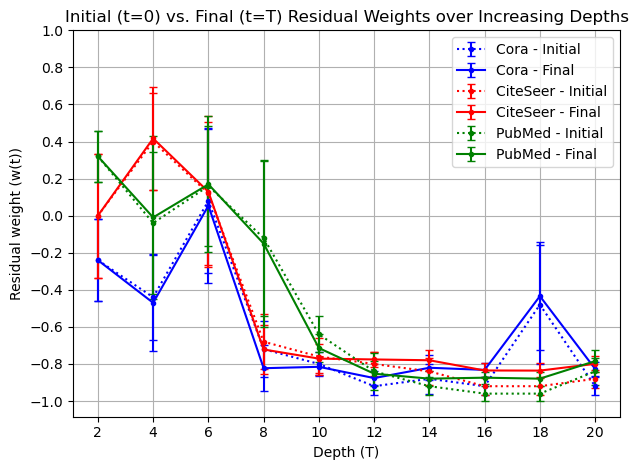

({'Cora': {2: -0.24000000059604645,
   4: -0.4700722806621343,
   6: 0.05404800772666931,
   8: -0.822844409942627,
   10: -0.8154059648513794,
   12: -0.8761218190193176,
   14: -0.8204541206359863,
   16: -0.8319651246070862,
   18: -0.43408302068710325,
   20: -0.8267160773277282},
  'CiteSeer': {2: 0.0,
   4: 0.41663115918636323,
   6: 0.12890626192092897,
   8: -0.7217857837677002,
   10: -0.7710992395877838,
   12: -0.7756174564361572,
   14: -0.7799771428108215,
   16: -0.83512442111969,
   18: -0.8357826948165894,
   20: -0.7992868661880493},
  'PubMed': {2: 0.320000010728836,
   4: -0.009362244606018066,
   6: 0.16936392784118653,
   8: -0.1506190061569214,
   10: -0.7140795826911926,
   12: -0.8525484323501586,
   14: -0.8791971325874328,
   16: -0.8740366458892822,
   18: -0.8791977643966675,
   20: -0.7846557974815369}},
 {'Cora': {2: 0.22271057528933588,
   4: 0.2595253000771934,
   6: 0.417661491928406,
   8: 0.12264676604292231,
   10: 0.045958083036498204,
   12: 0.0372

In [191]:
plot_res_weights(dataset_to_results, layers=TRAIN_LAYERS)

In [221]:
def plot_acc_vs_nlayers(experimental_results, dataset_name):  # model name to avg scores
    # model : { num layers : (avg results, std results) }
    model_to_results = extract_results(experimental_results, layers=TRAIN_LAYERS)
    
    plt.figure(figsize=(8, 6))
    # Plot the average accuracy for each class of model
    for model_name, results in model_to_results.items():
        avg_accs = [results[n][0]['mic_f1'] for n in TRAIN_LAYERS]
        stderr_accs = [results[n][1]['mic_f1'] for n in TRAIN_LAYERS]
        plt.errorbar(TRAIN_LAYERS, avg_accs, yerr=stderr_accs,
                     label=model_name, fmt='o', capsize=3, linestyle='-', markersize=4.5)
    
    # Customize the plot
    plt.xlabel('Number of Layers')
    plt.ylabel('Average Accuracy')
    plt.xticks(layers)
    plt.yticks(np.arange(0,1,0.1))
    plt.title('Average Accuracy over Different Number of Layers')
    plt.legend()
    plt.savefig(f'./results/{dataset_name}/acc_vs_nlayers.png', format='png')
    
    # Show the plot
    plt.grid(True)
    plt.tight_layout()
    plt.show()

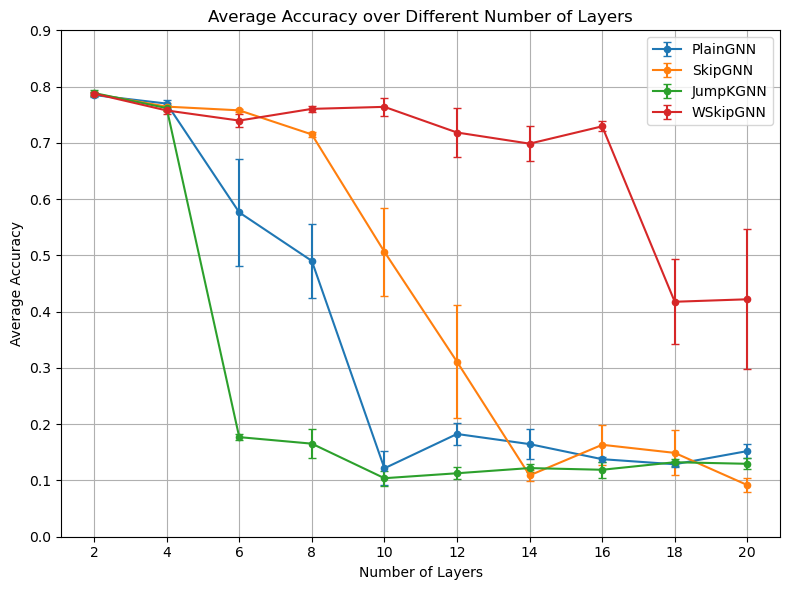

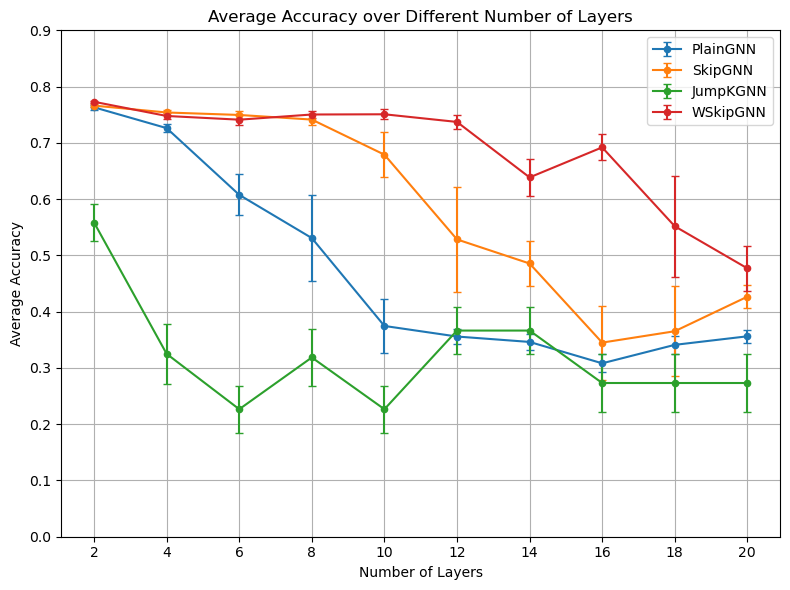

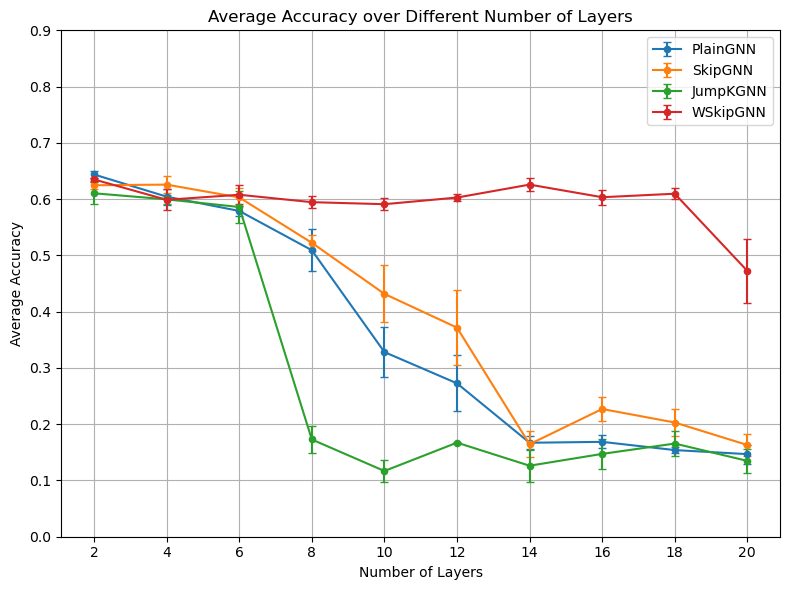

In [222]:
plot_acc_vs_nlayers(cora_results, 'Cora')
plot_acc_vs_nlayers(pubmed_results, 'PubMed')
plot_acc_vs_nlayers(citeseer_results, 'CiteSeer')

## Visualise node embeddings generated by each model

In [109]:
def gen_sample_results(dataset_name, experiment_results, 
                       export_results=True):
    """
    Returns sample results as a dictionary of 
    model : { num layers : (layers_to_model, layers_to_results, layers_to_hyperparams) }
    for all models.
    """
    layers_to_init_ws = extract_all_init_res_weights(experiment_results)
    layers_to_mean_init_ws = { n: np.mean(ws) for n,ws in layers_to_init_ws.items() } # use mean optimal init. residual weight from training
    model_to_hyperparams = { m : {n: training_params(m, dataset_name, n_layers=n, 
                                                     init_res_weight=layers_to_init_ws[n]) 
                                 for n in TRAIN_LAYERS }
                            for m in MODELS }
    
    flatten_single_dict = (lambda triple, n: (triple[0][n], triple[1][n], triple[2][n]))
    sample_results = {model: { n: flatten_single_dict(
                                        train_and_test(layers_to_params[n], layers=[n], 
                                                       print_results=False), n)
                              for n in TRAIN_LAYERS }
                      for model, layers_to_params in model_to_hyperparams.items() }
    return sample_results

In [214]:
def visualise_embeddings_for_all_models(experiment_results, dataset_name, export_results=False):
    sample_results = gen_sample_results(dataset_name, experiment_results, export_results=export_results)
    for model_name, layers_to_results in sample_results.items():
        models = { n: res[0] for n, res in layers_to_results.items() }
        visualise_embeddings(models, model_name, dataset_name)

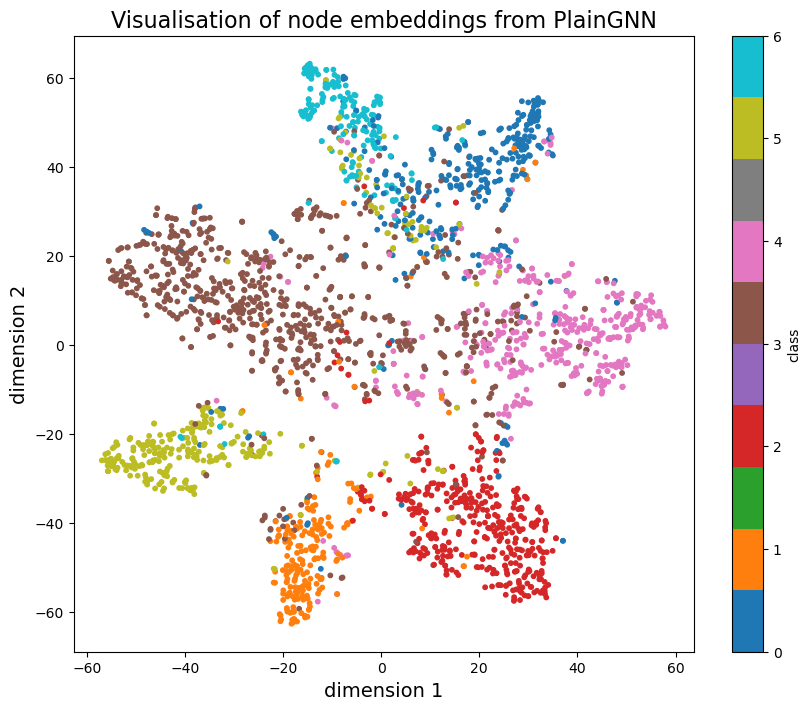

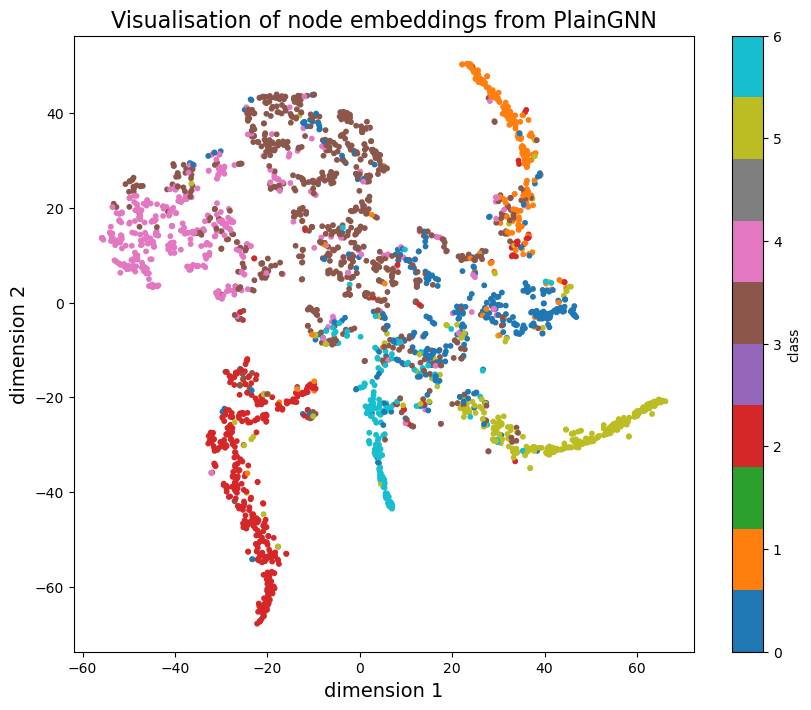

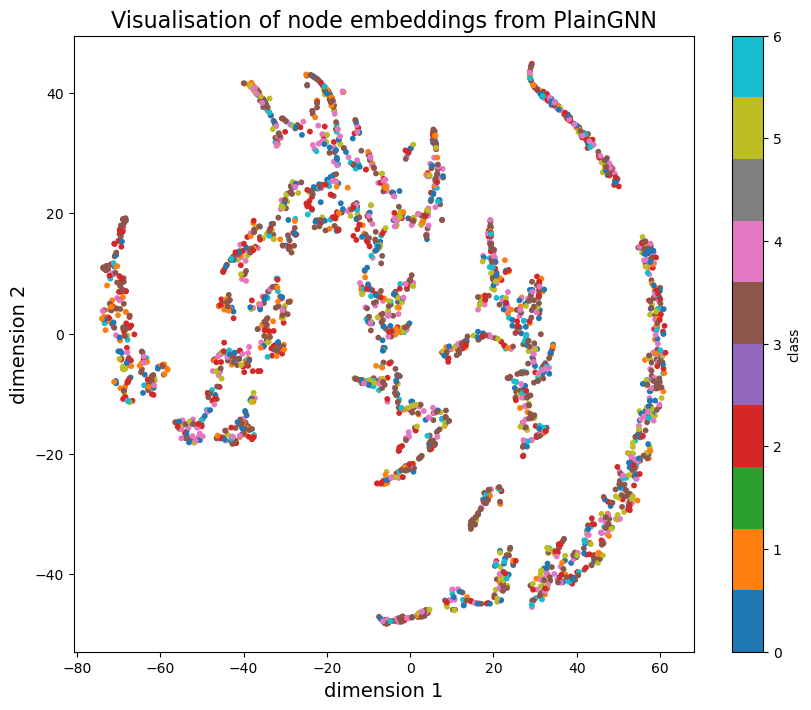

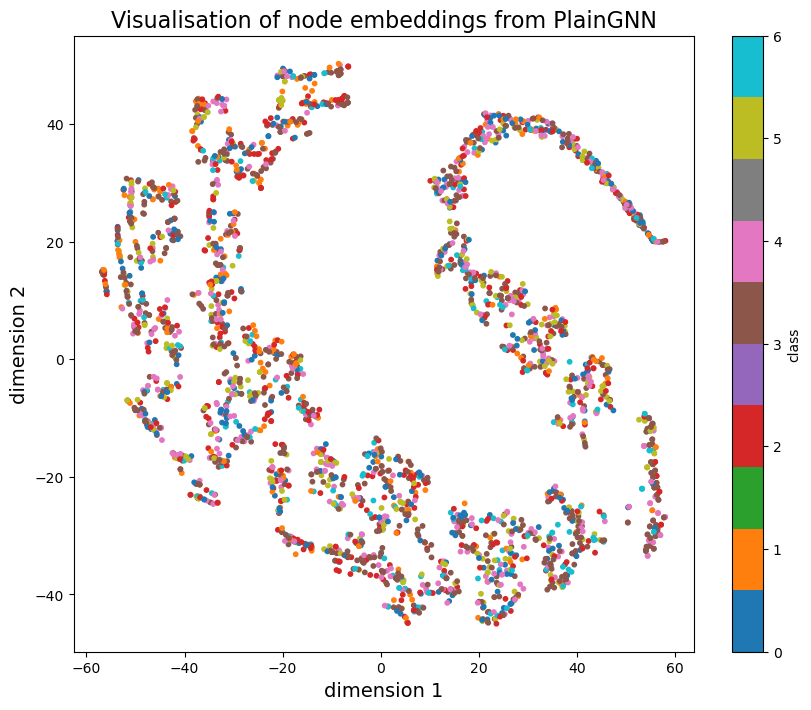

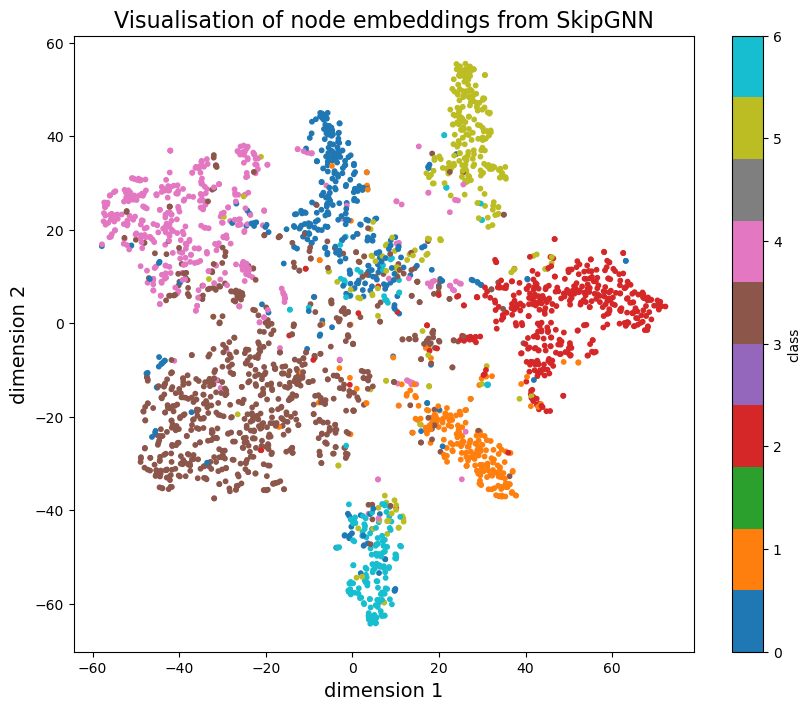

...

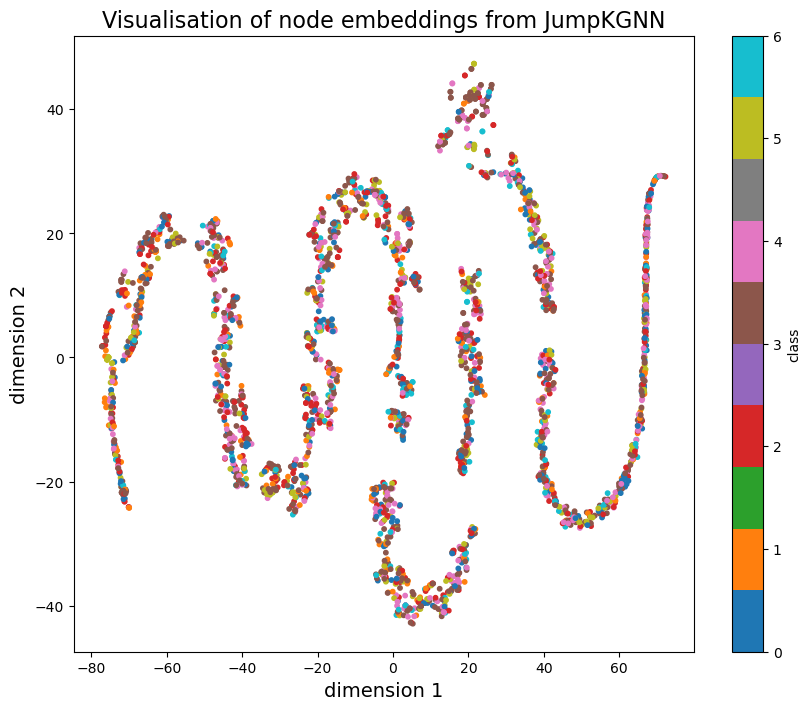

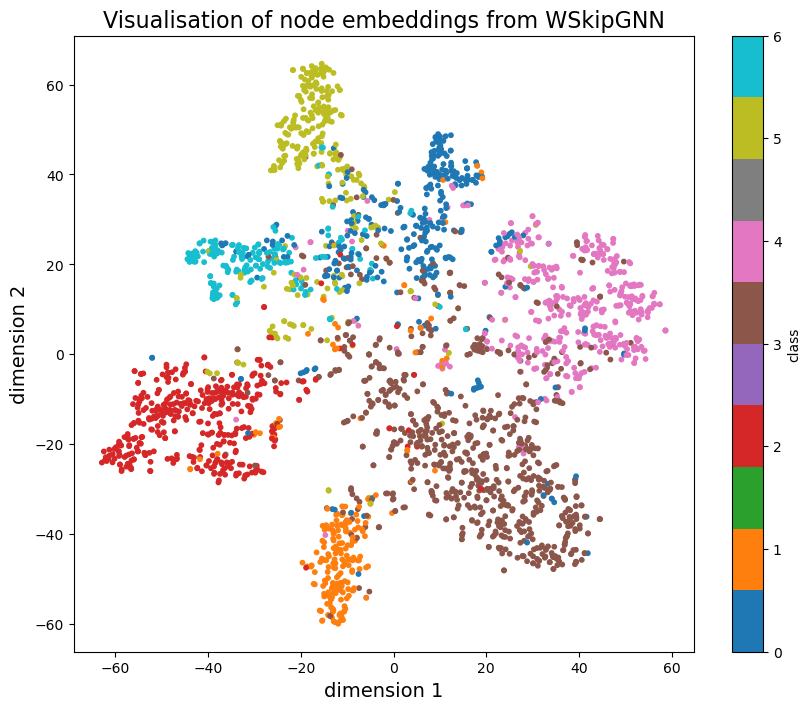

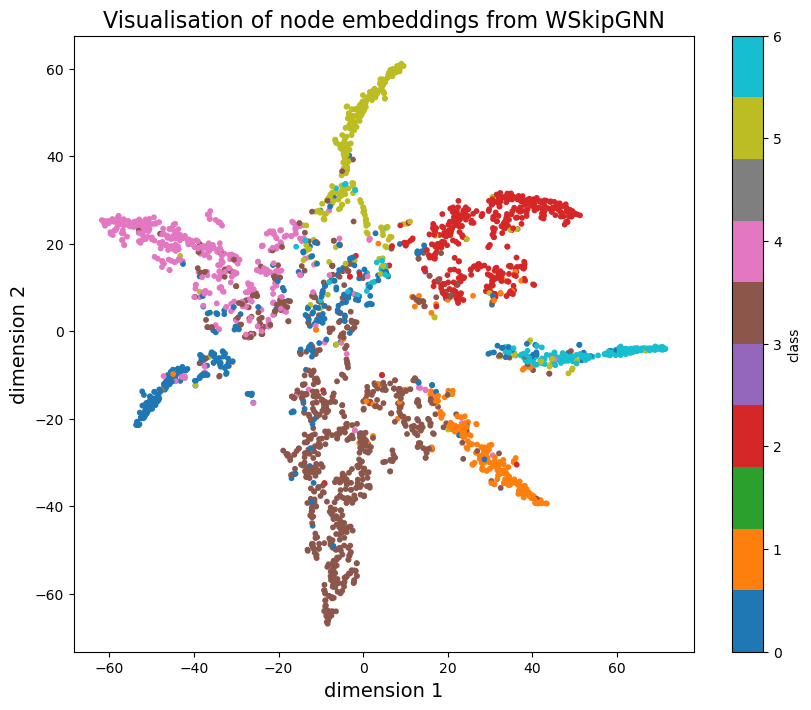

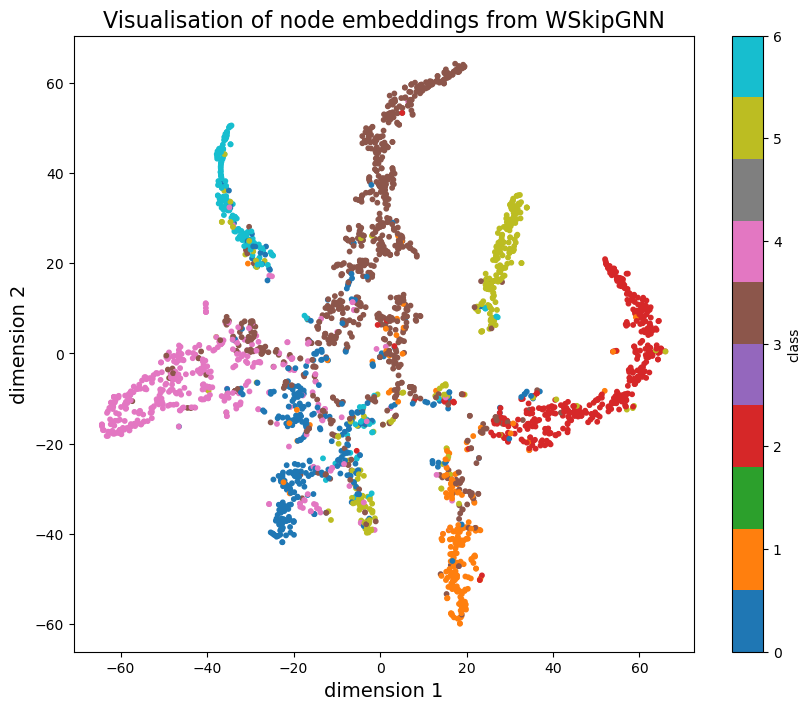

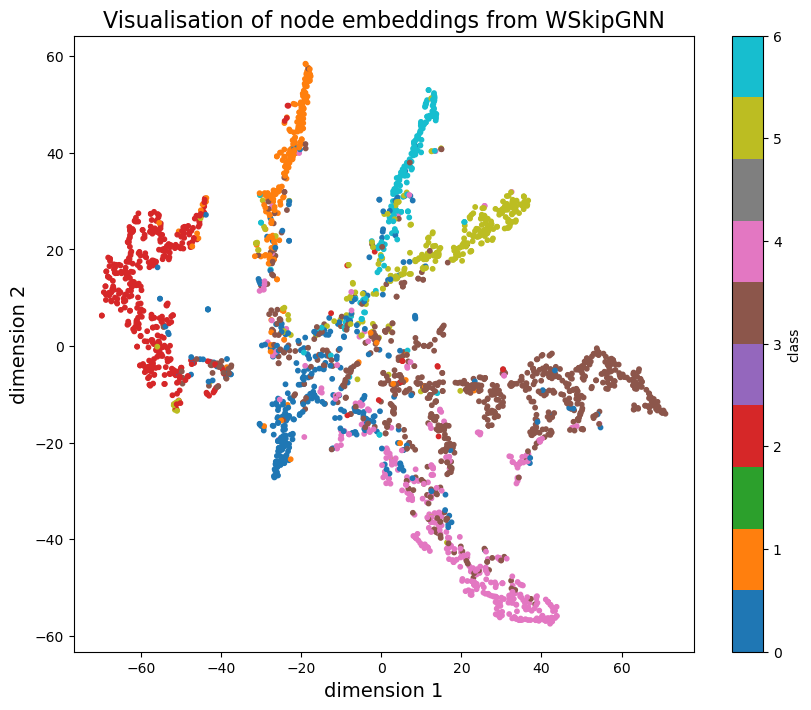

In [112]:
visualise_embeddings_for_all_models(cora_results, 'Cora')

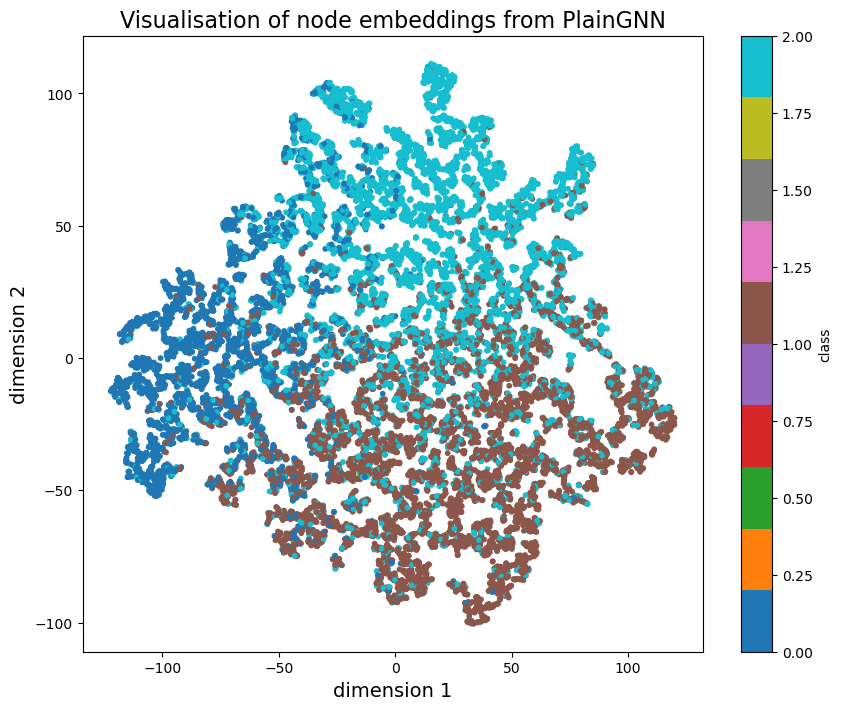

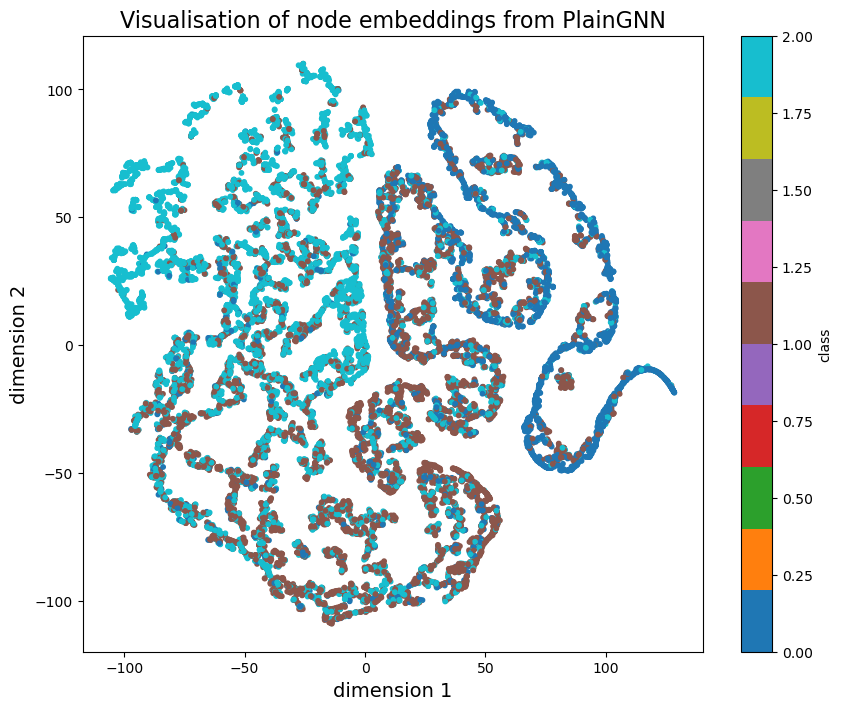

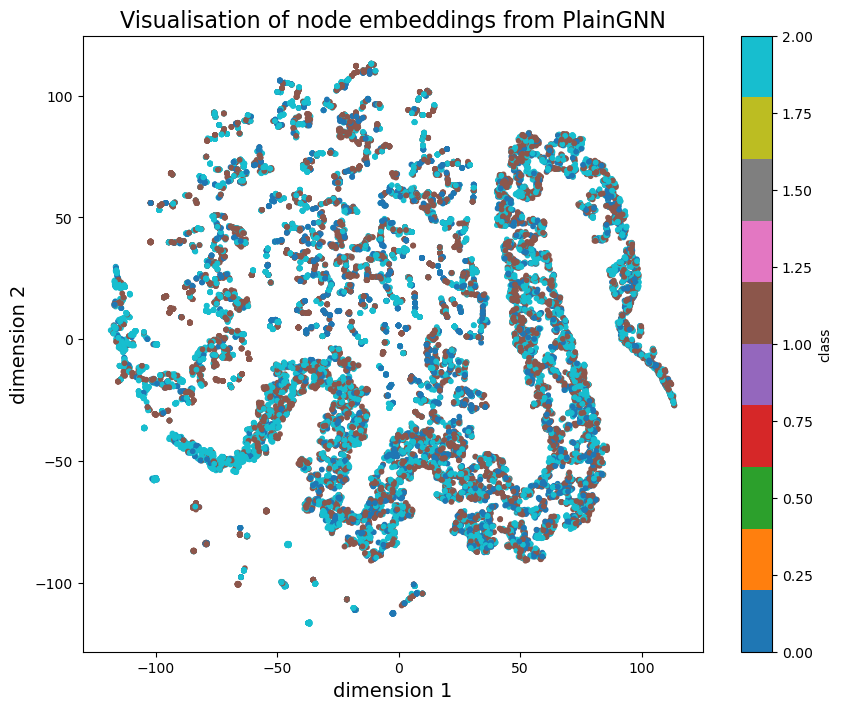

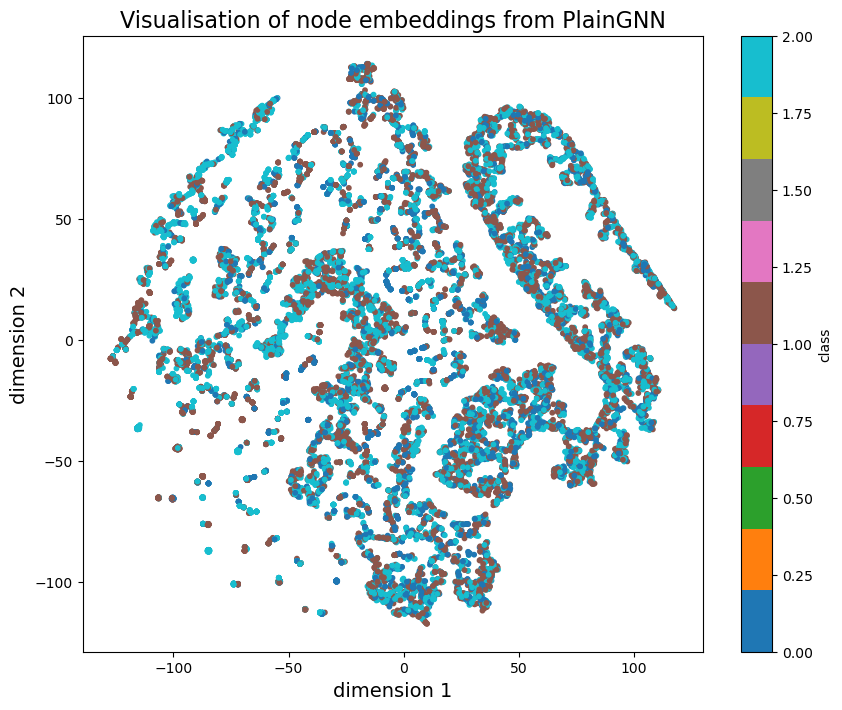

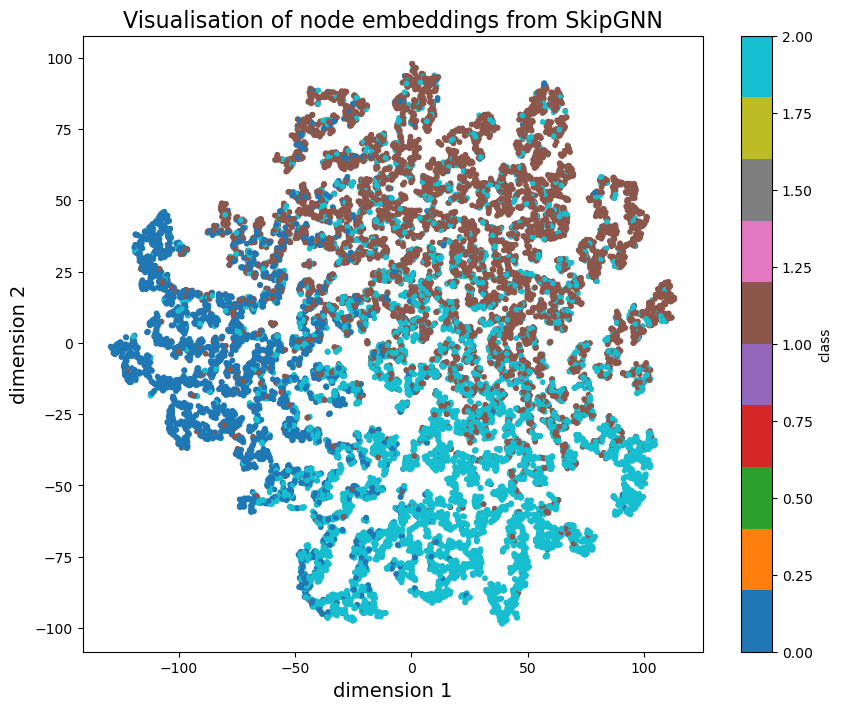

...

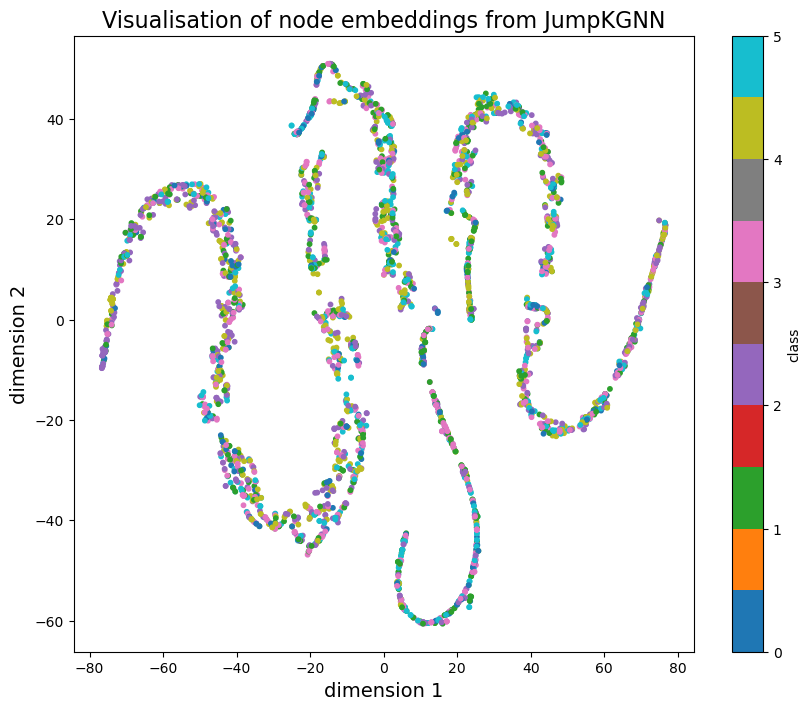

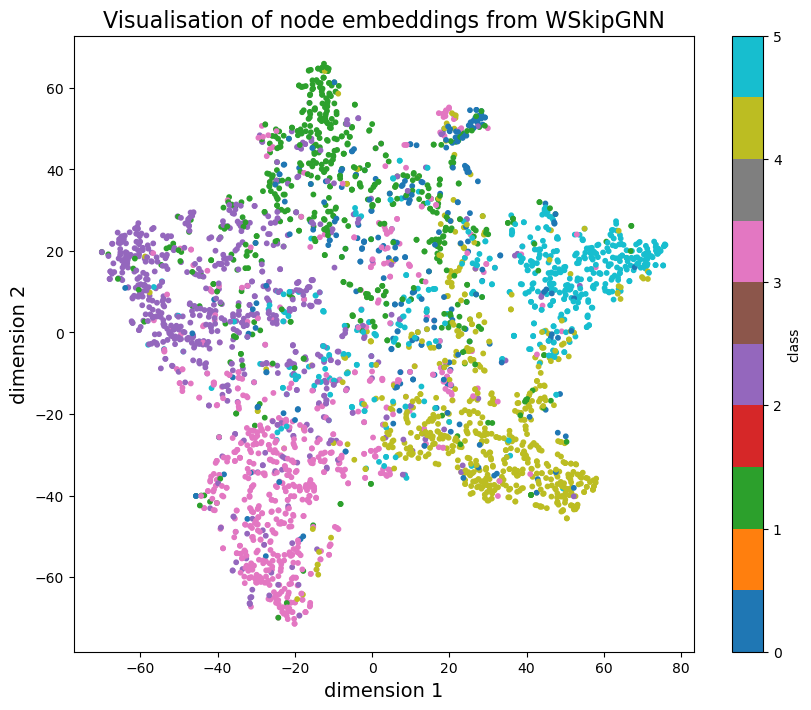

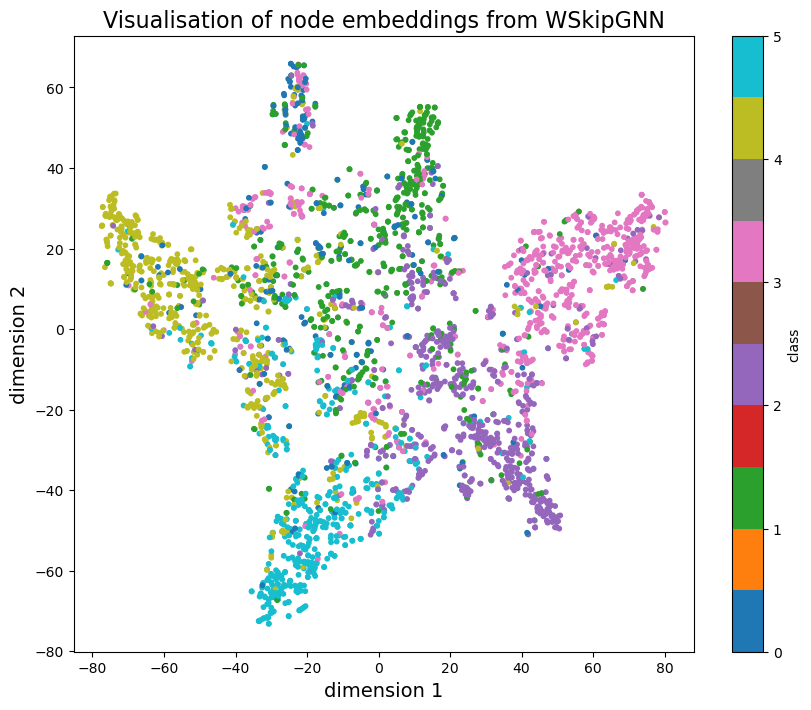

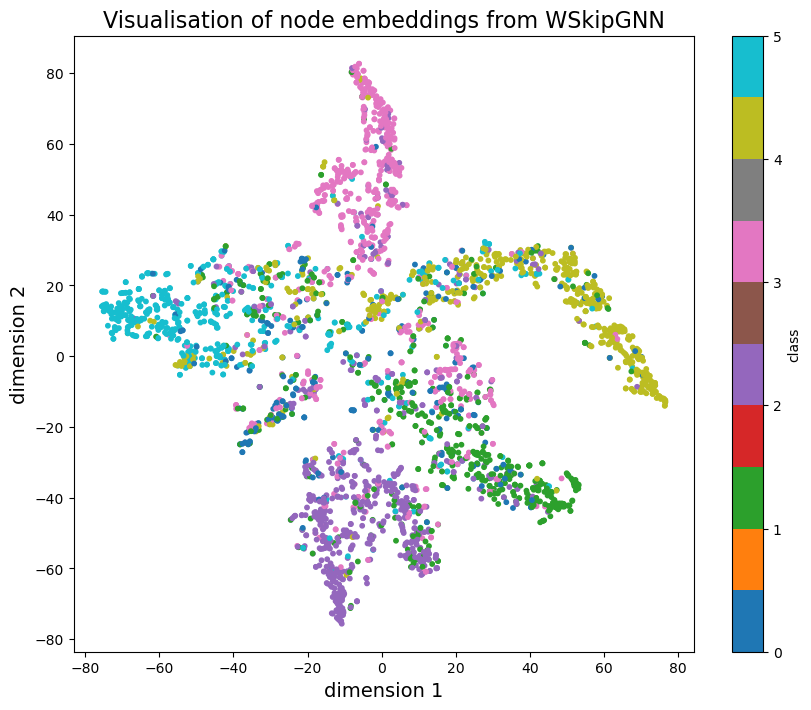

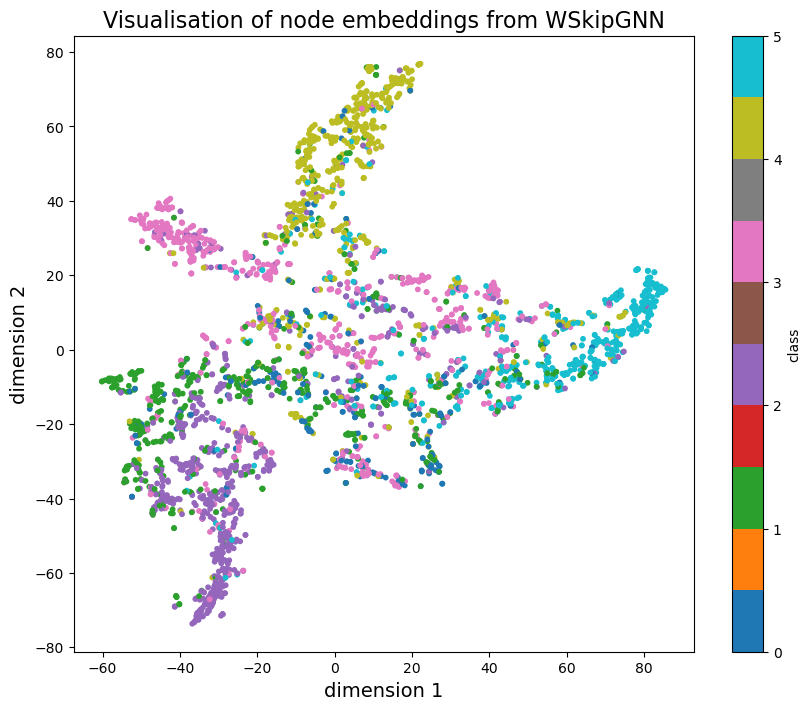

In [177]:
visualise_embeddings_for_all_models(pubmed_results, 'PubMed')
visualise_embeddings_for_all_models(citeseer_results, 'CiteSeer')

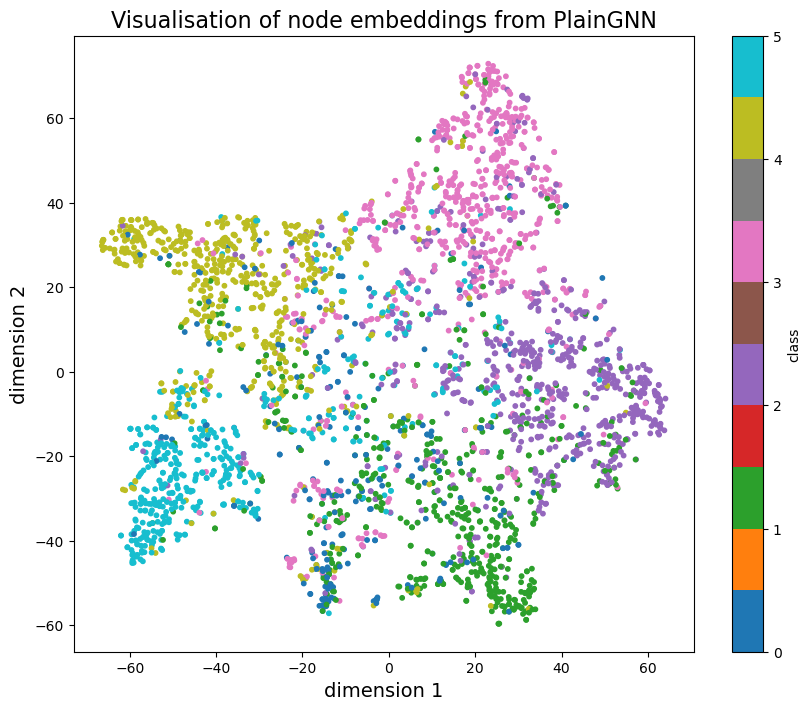

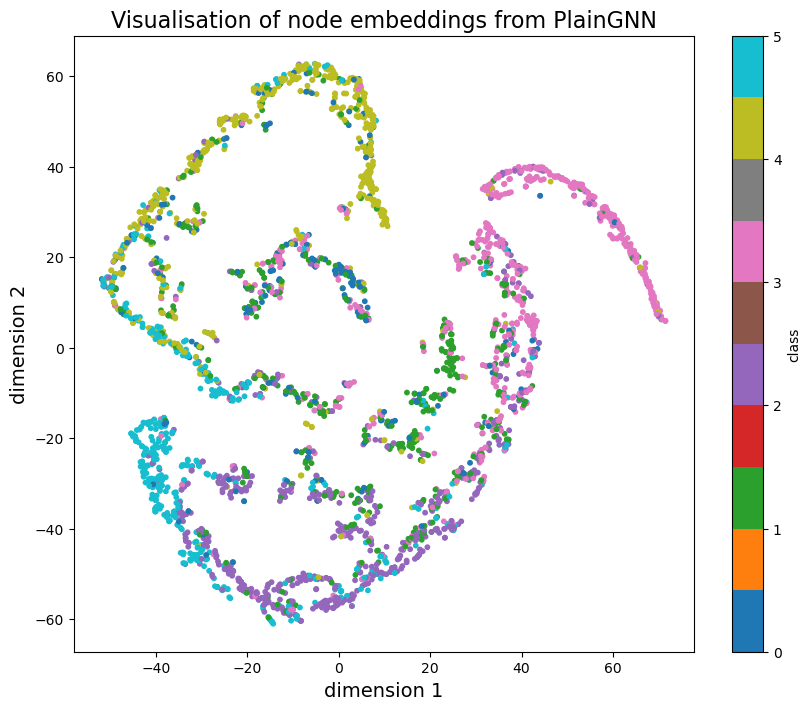

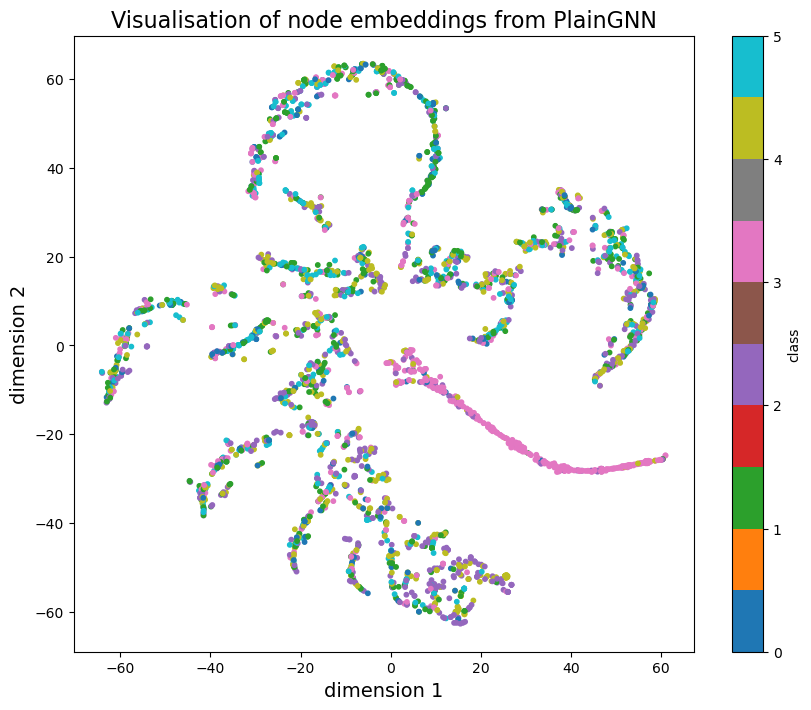

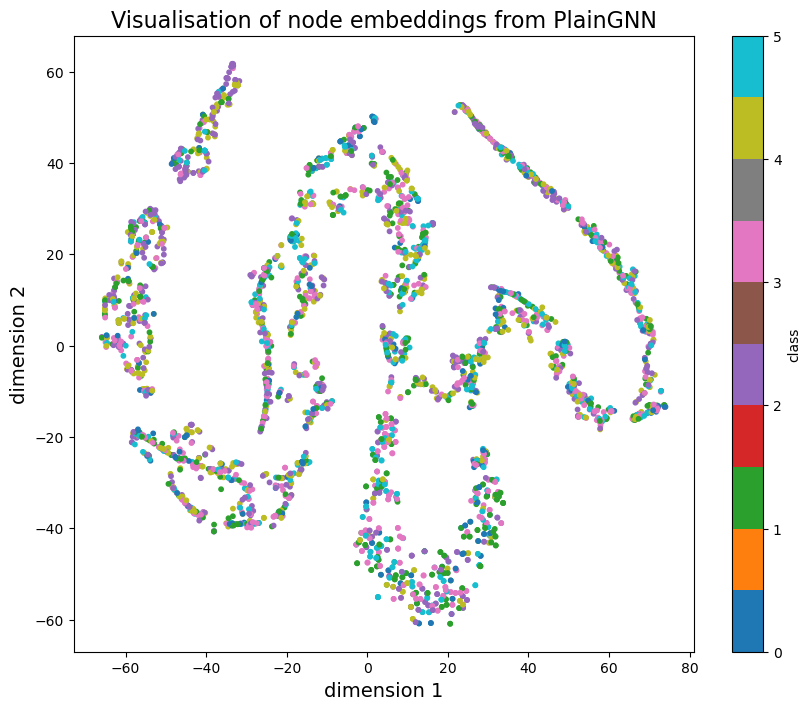

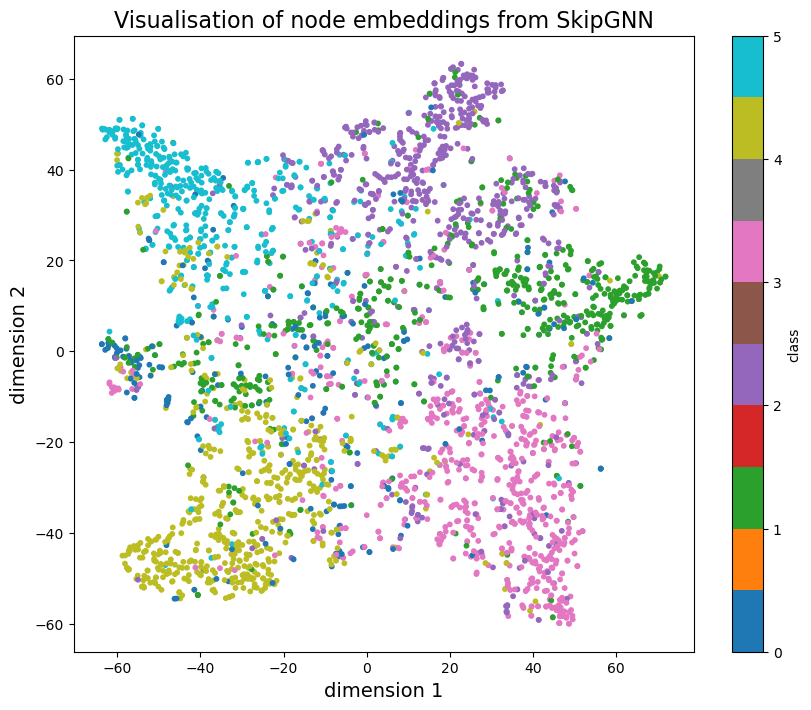

...

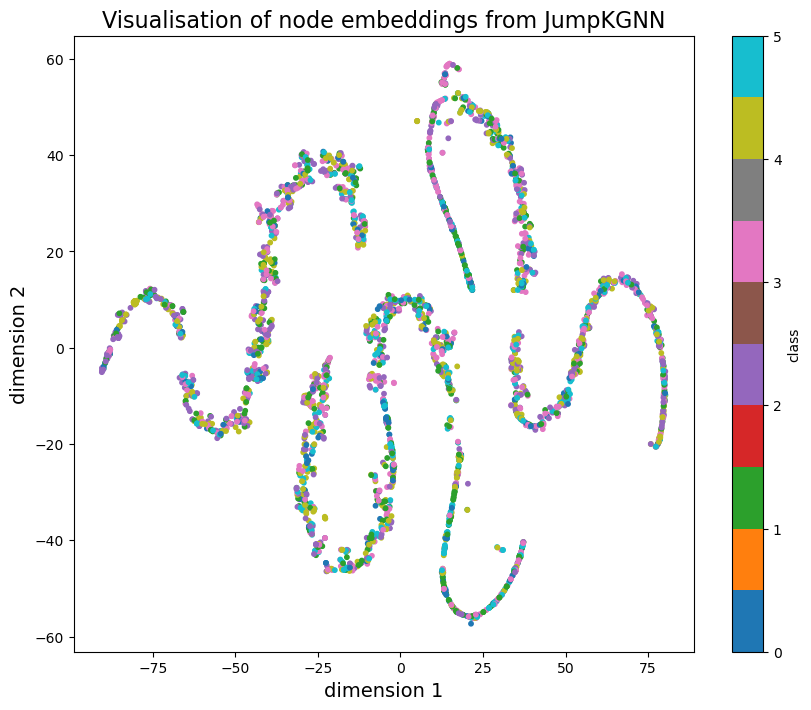

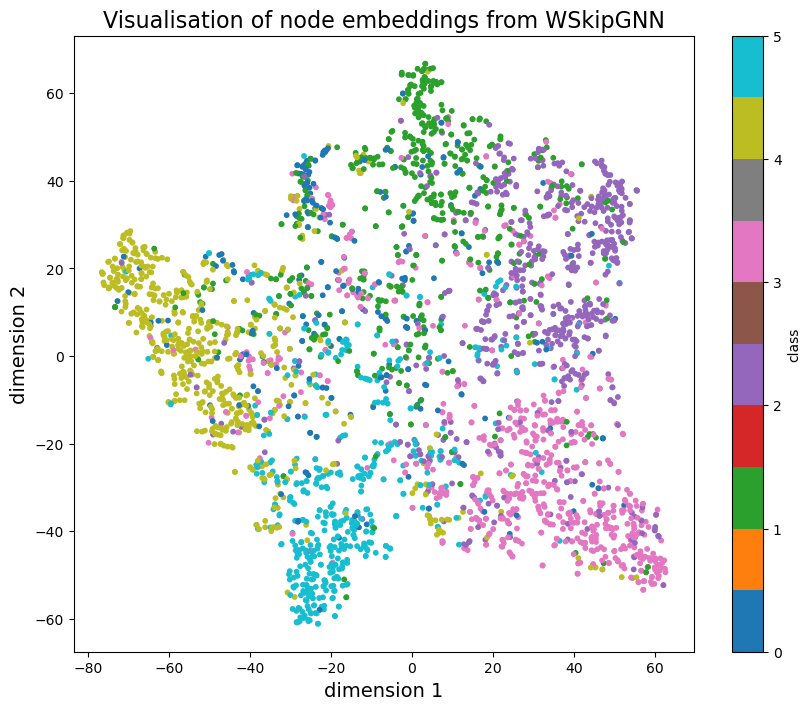

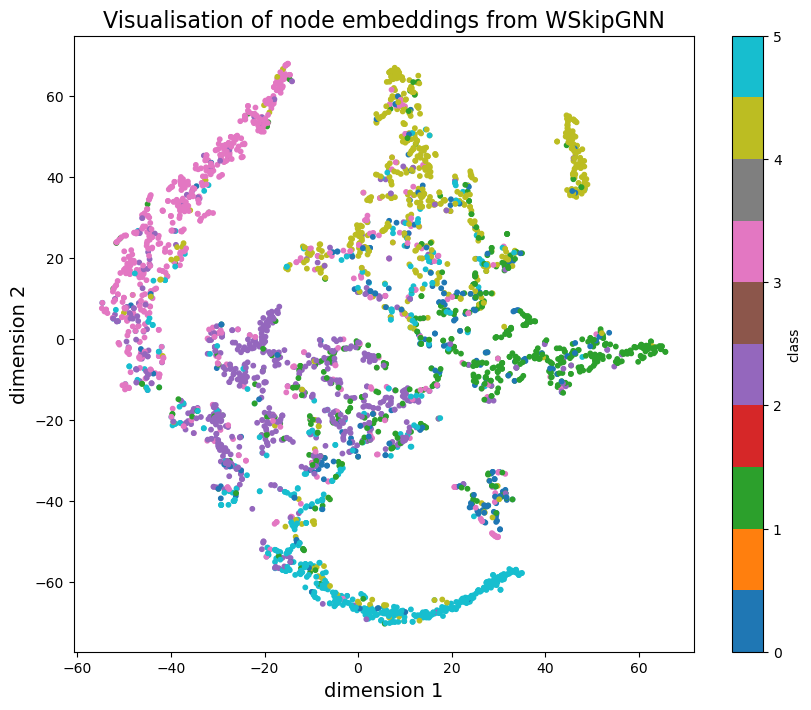

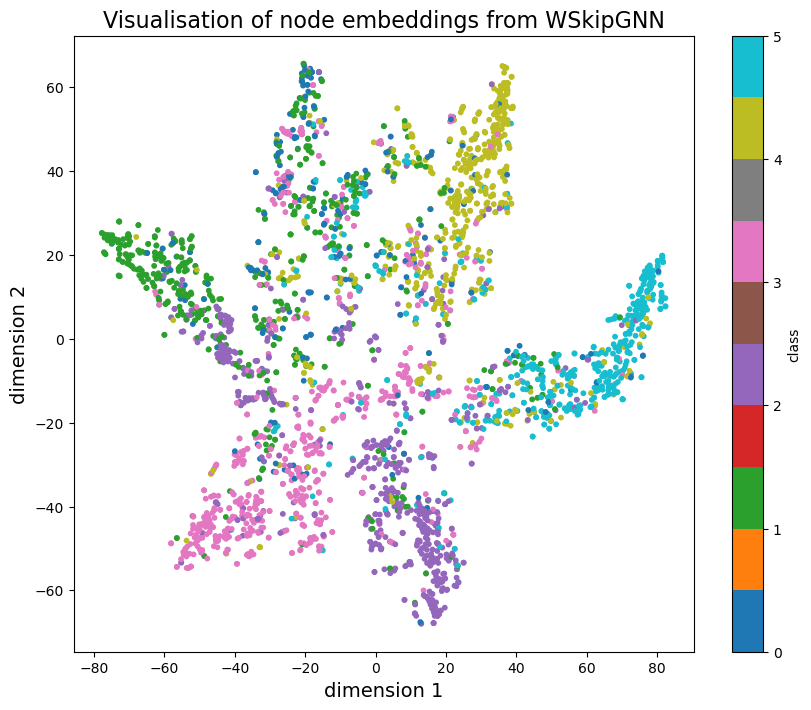

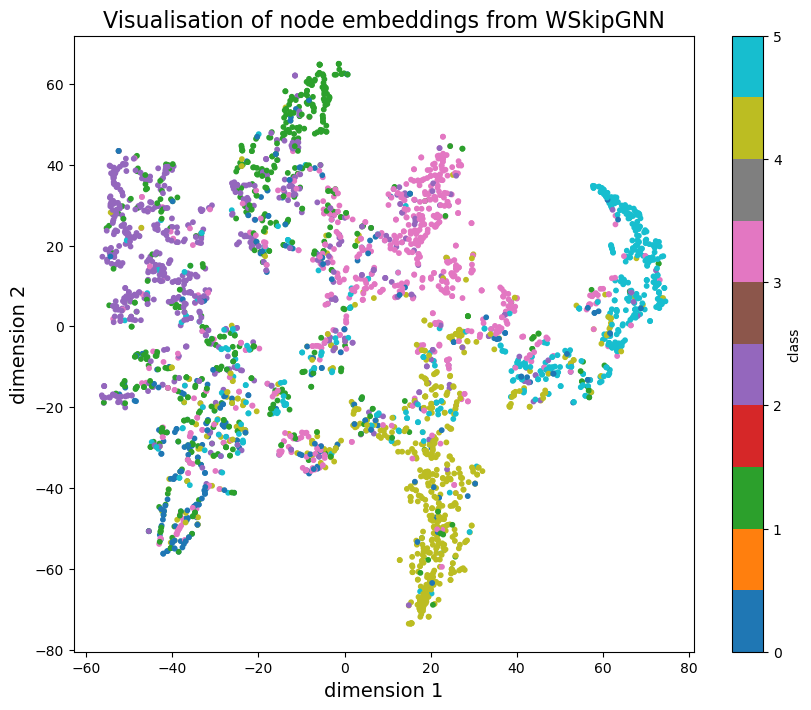

In [216]:
visualise_embeddings_for_all_models({'WSkipGNN': citeseer_results['WSkipGNN']}, 'CiteSeer', export_results='True')

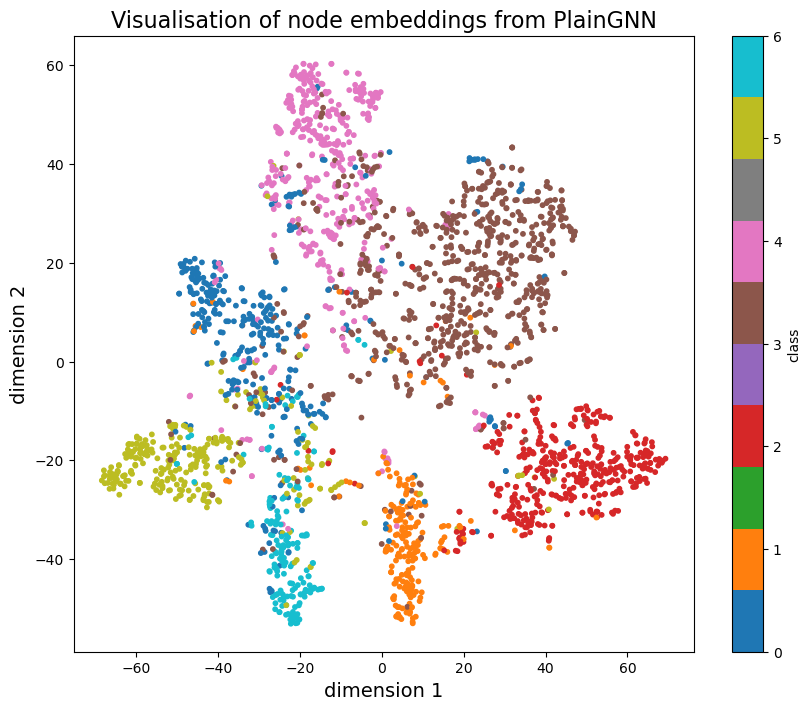

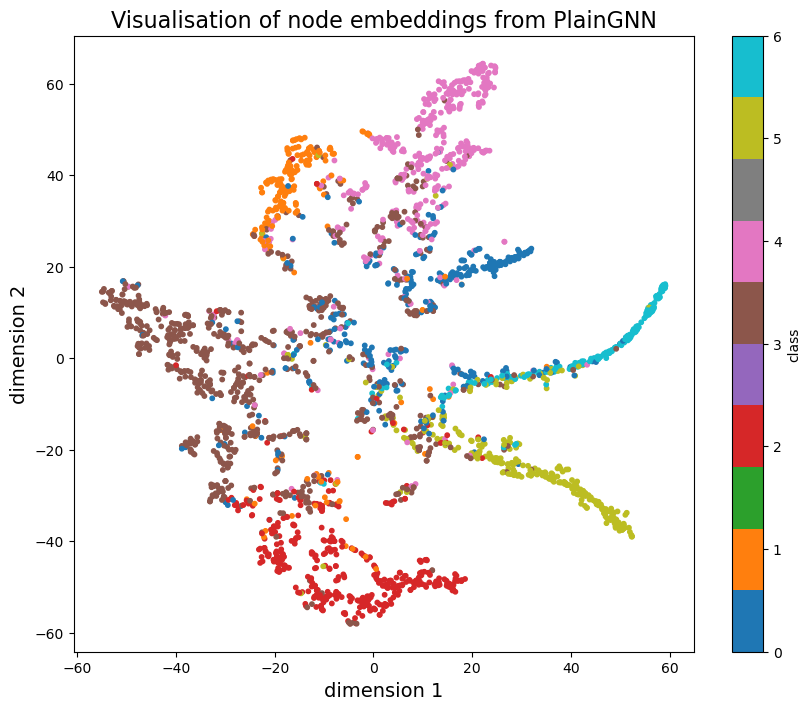

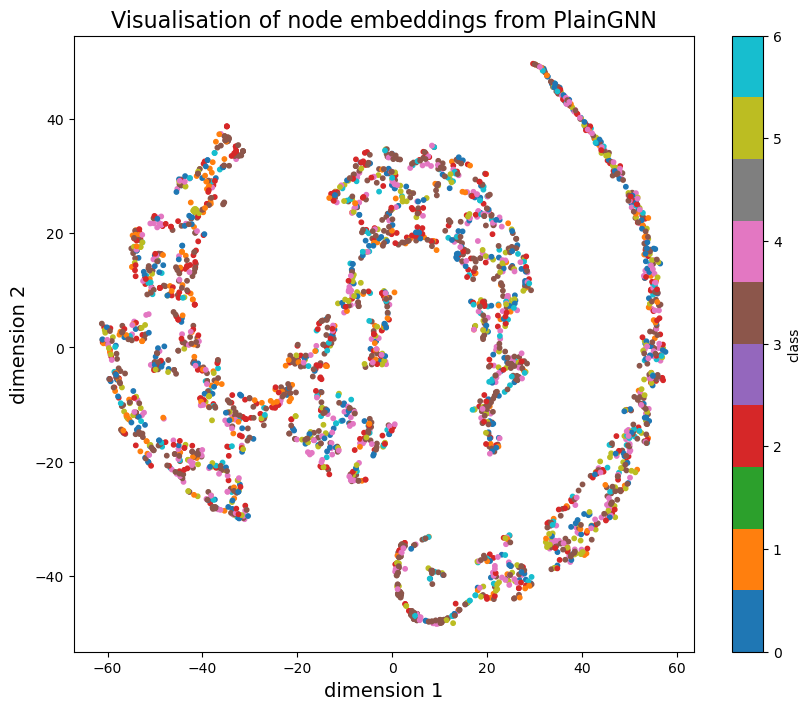

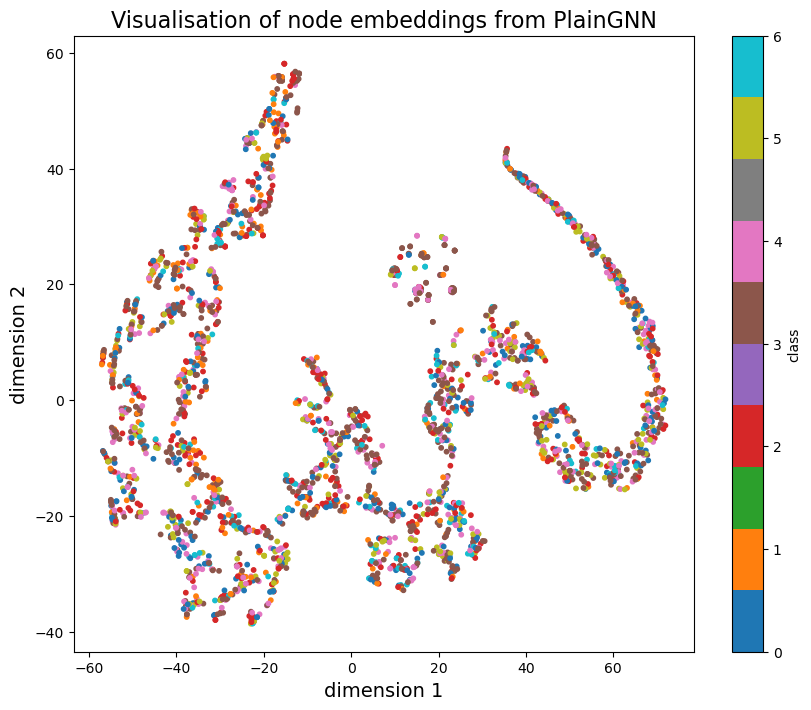

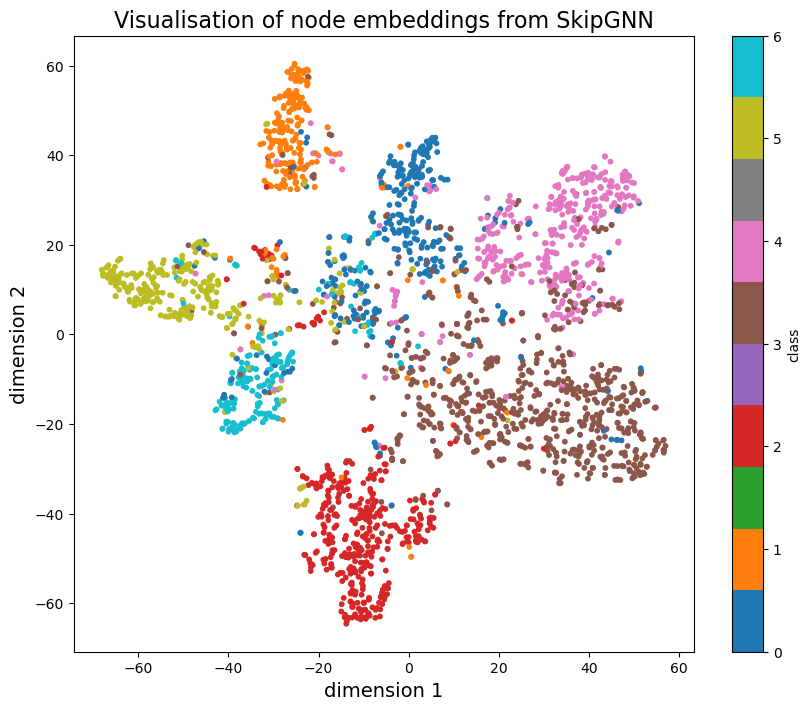

...

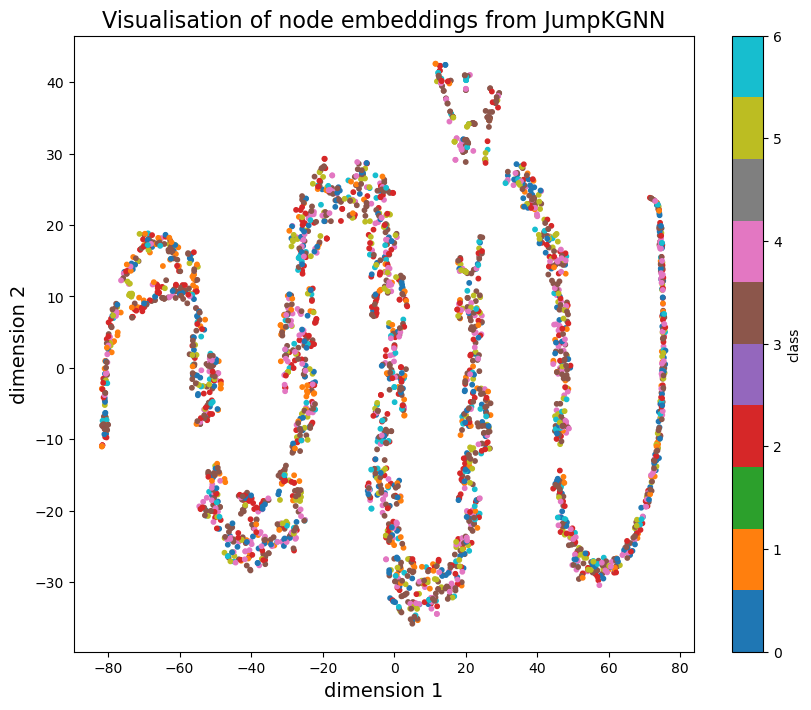

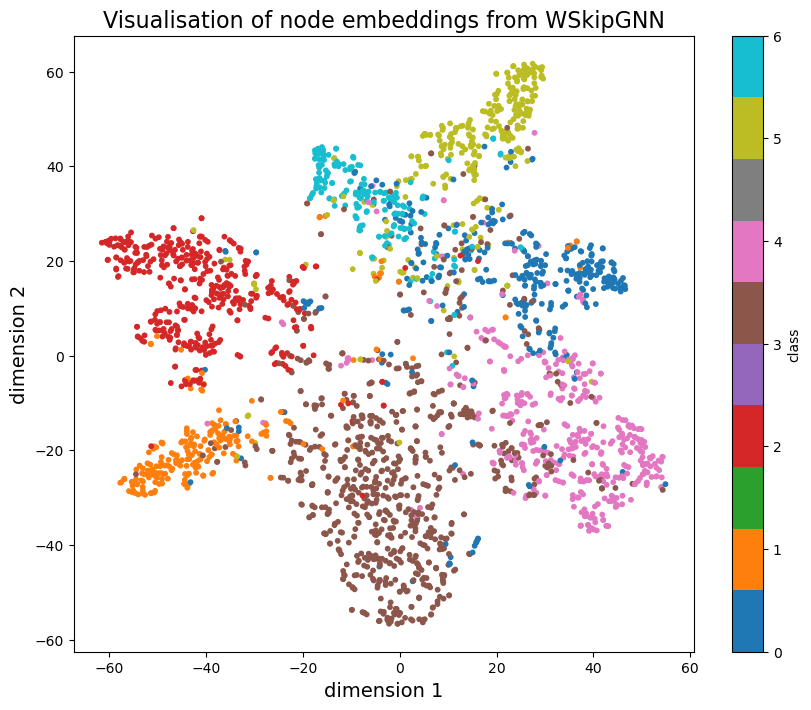

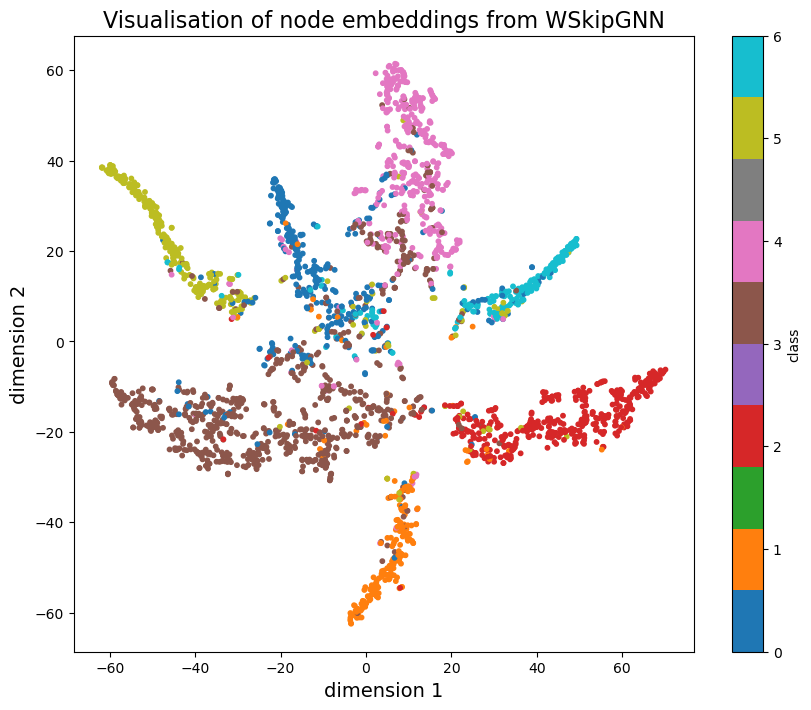

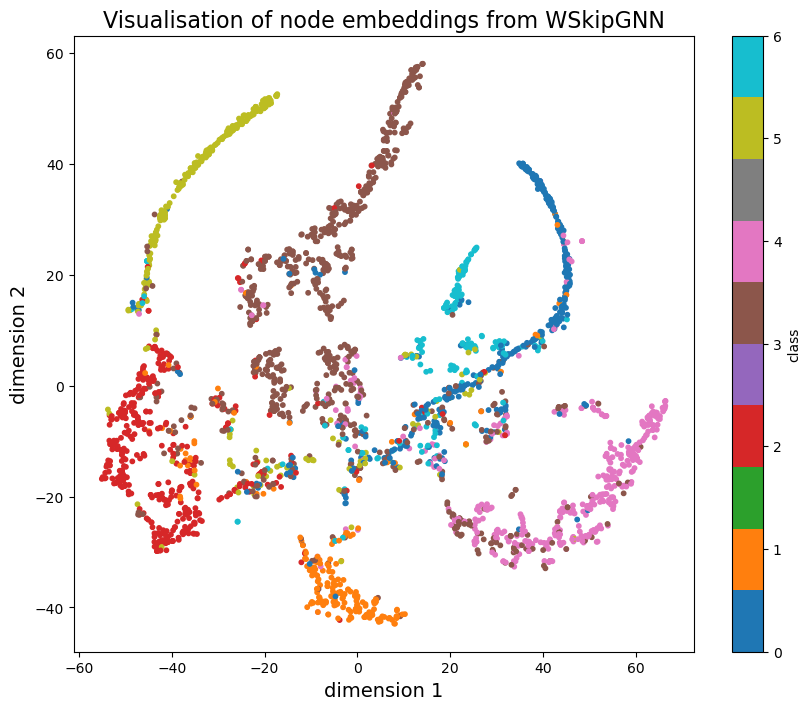

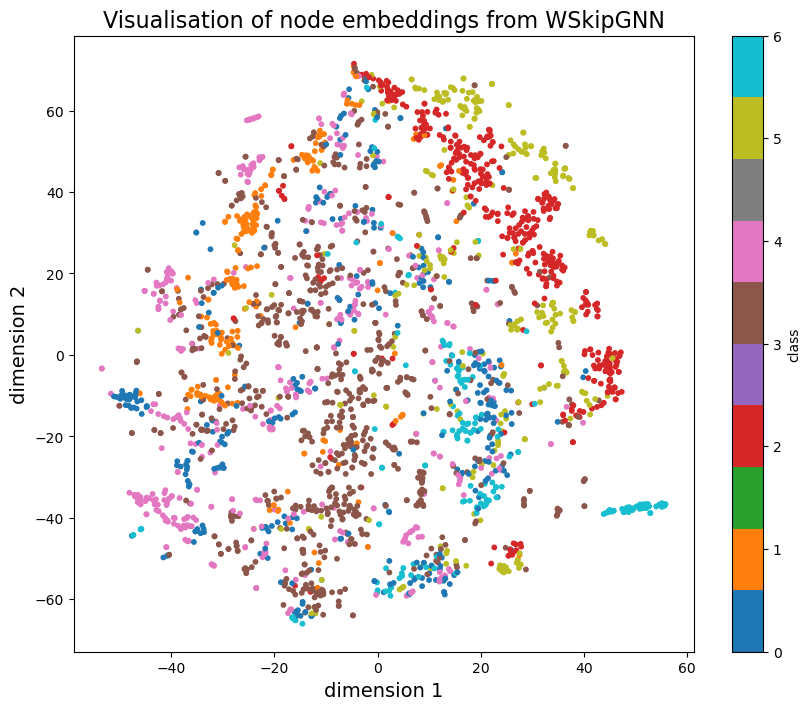

In [217]:
visualise_embeddings_for_all_models({'WSkipGNN': cora_results['WSkipGNN']}, 'Cora', export_results='True')

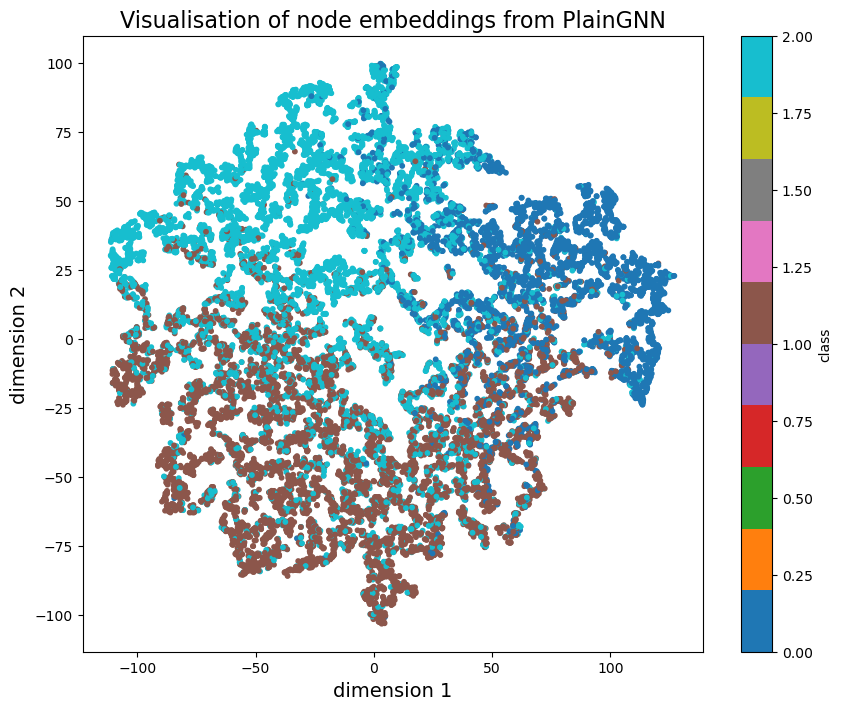

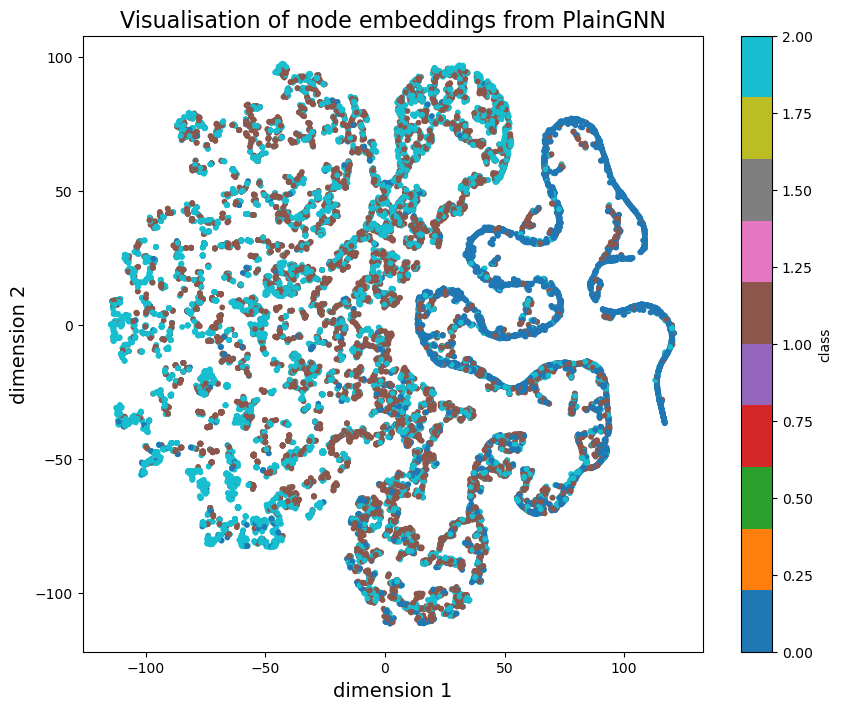

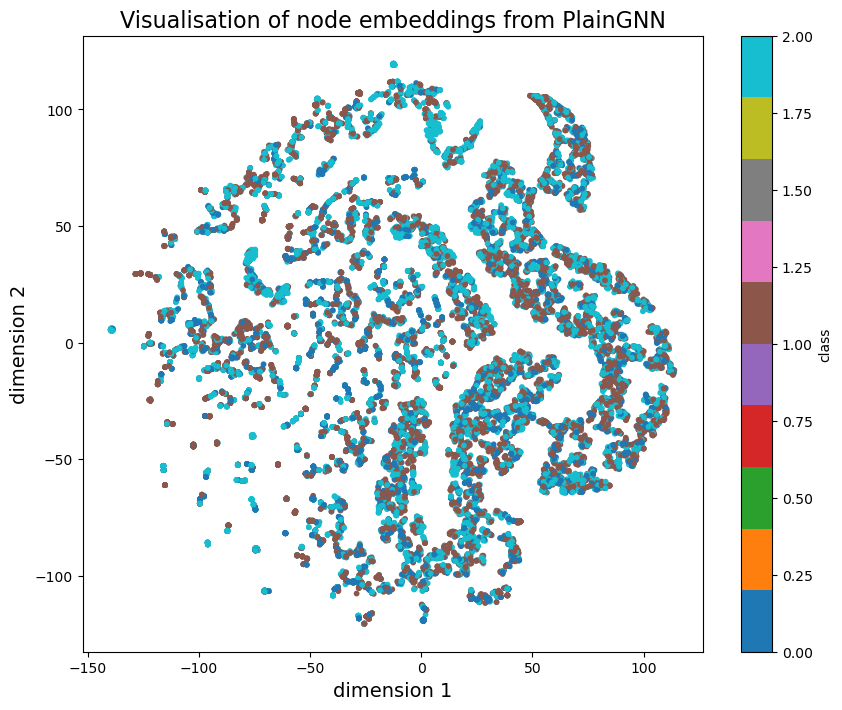

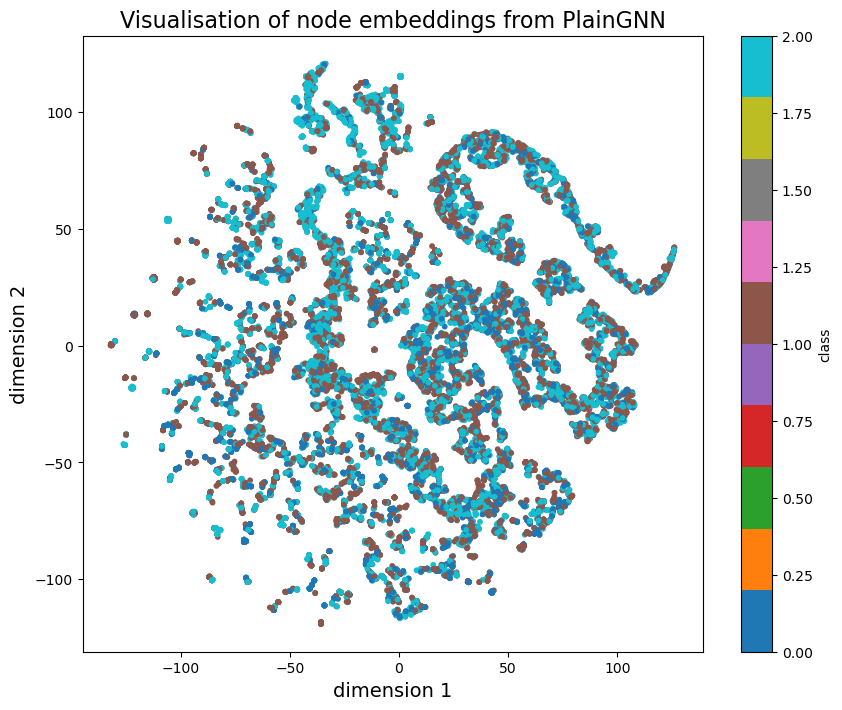

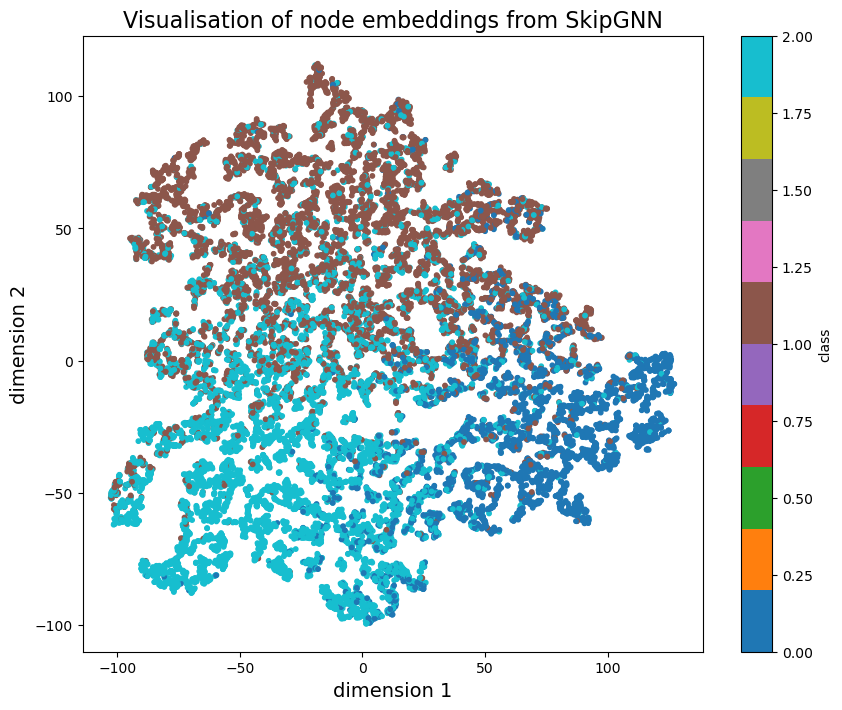

...

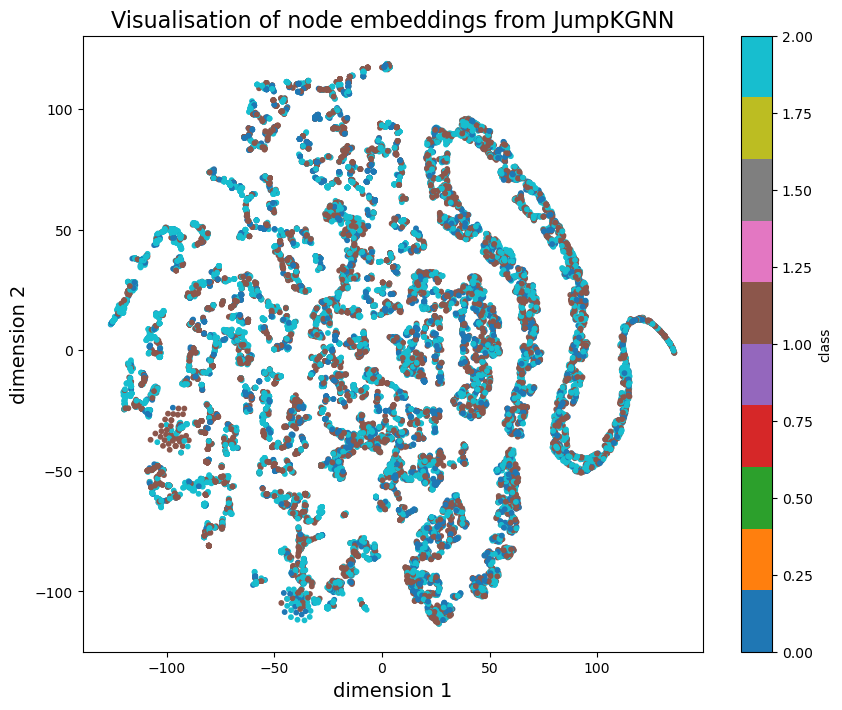

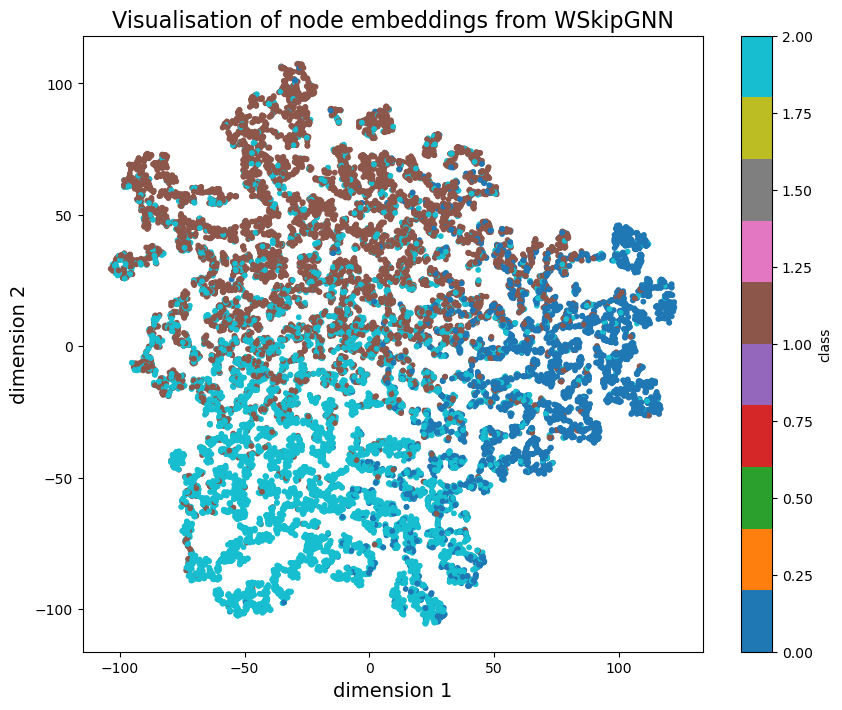

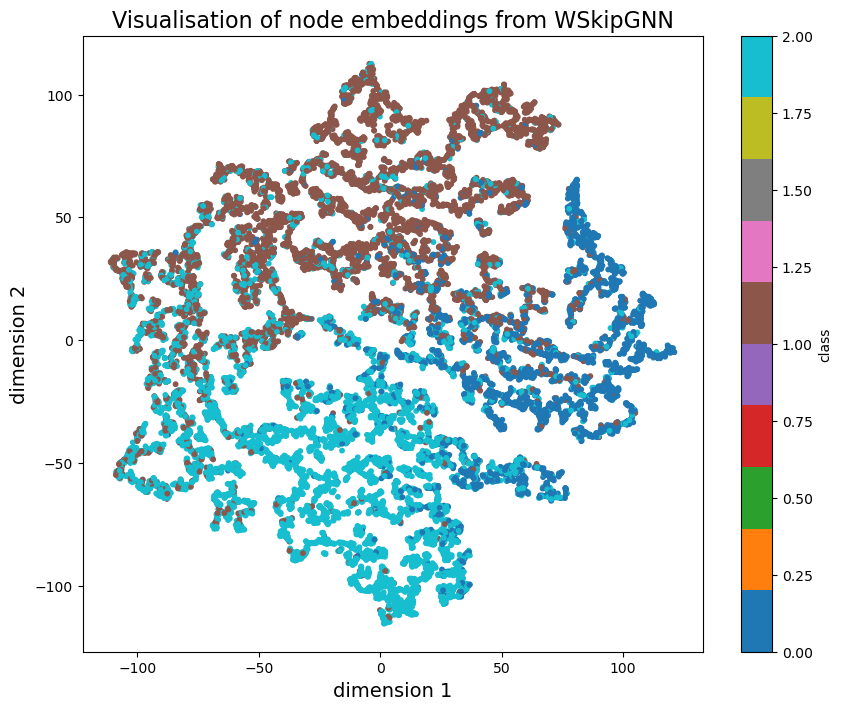

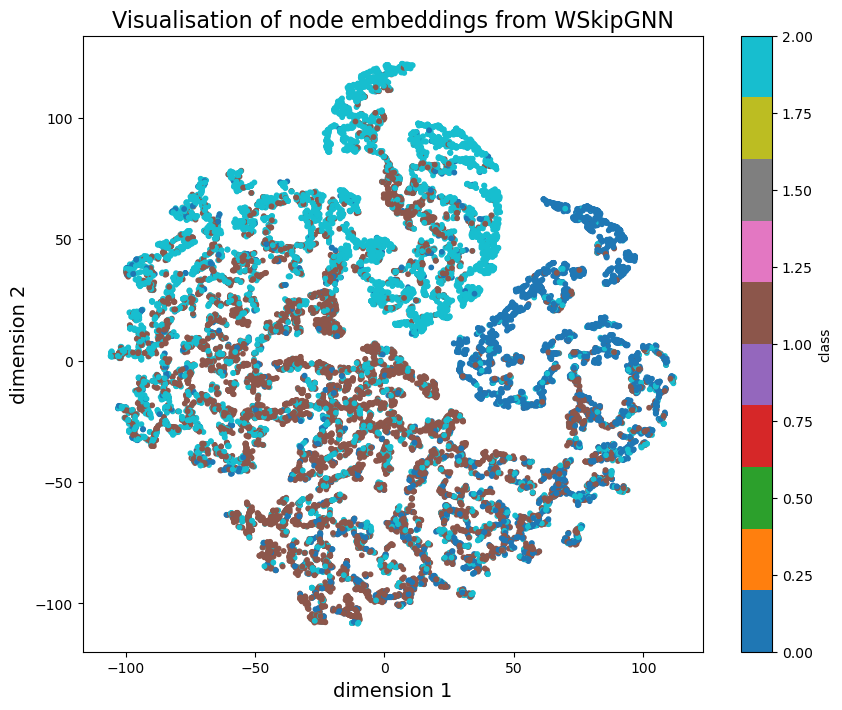

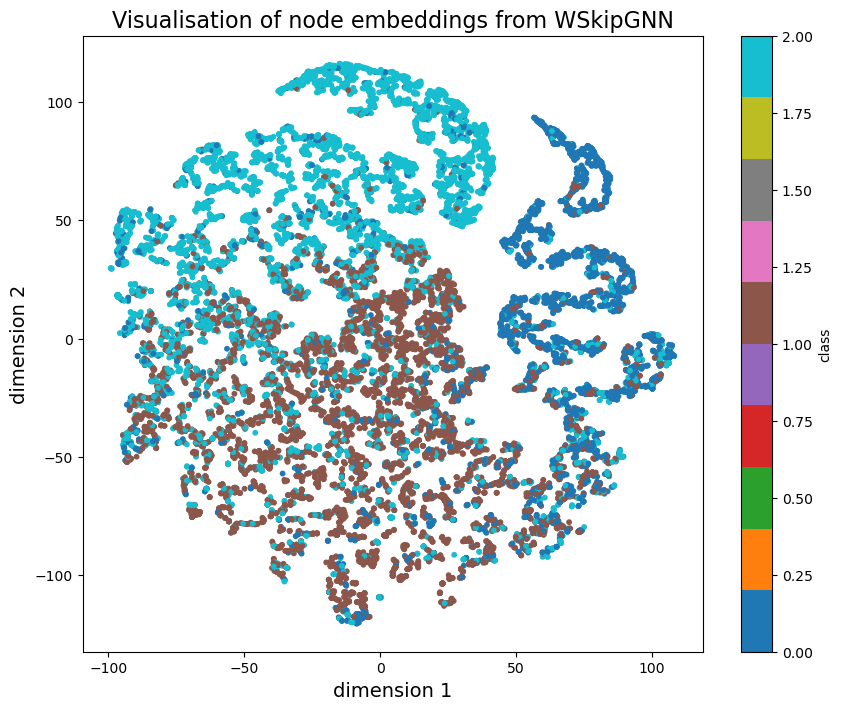

In [218]:
visualise_embeddings_for_all_models({'WSkipGNN': pubmed_results['WSkipGNN']}, 'PubMed', export_results='True')